In [1]:
import sys
sys.path.append('..')
from gamadhani.utils.generate_utils import load_audio_fns
from gamadhani.utils.utils import get_device
import gin
from functools import partial
import torch
import gamadhani.utils.pitch_to_audio_utils as p2a
import numpy as np
import matplotlib.pyplot as plt

/home/mila/n/nithya.shikarpur/.conda/envs/test-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/mila/n/nithya.shikarpur/.conda/envs/test-env/lib/python3.10/site-packages/x_transformers/x_transformers.py:445: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @autocast(enabled = False)
/home/mila/n/nithya.shikarpur/.conda/envs/test-env/lib/python3.10/site-packages/x_transformers/x_transformers.py:469: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @autocast(enabled = False)


In [2]:
prime_file = '/home/mila/n/nithya.shikarpur/scratch/final-data-ismir/data/merged_data-finalest/listening_study_primes.npz'
audio_model = '/home/mila/n/nithya.shikarpur/scratch/final-data-ismir/models/pitch-to-audio'
audio_qt = '/home/mila/n/nithya.shikarpur/scratch/final-data-ismir/models/pitch-to-audio/qt.joblib'
config_path = '/home/mila/n/nithya.shikarpur/scratch/final-data-ismir/models/pitch-to-audio/config.gin'

In [3]:
primes = np.load(prime_file, allow_pickle=True)
pitch_vals = [p[0][:2400] for p in primes['concatenated_array']] # only use first 12 s of each sample

In [4]:
device = get_device()
audio_model, audio_qt, audio_seq_len, invert_audio_fn = load_audio_fns(audio_path=audio_model,
    qt_path=audio_qt,
    config_path=config_path,
device=device)

Script is running on: GPU


/home/mila/n/nithya.shikarpur/GaMaDHaNi-dev/quantization-studies/../gamadhani/utils/generate_utils.py:47: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(ckp

In [5]:
# preprocess pitch to feed it as conditioning to the spectrogram generator

# parse pitch config
gin.parse_config_file('/home/mila/n/nithya.shikarpur/GaMaDHaNi-dev/configs/diffusion_pitch_config.gin')
Task_ = gin.get_configurable('src.dataset.Task')
task_obj = Task_()
pitch_task_fn = partial(task_obj.read_)
invert_pitch_task_fn = partial(task_obj.invert_)

In [6]:
processed_pitch_val = [pitch_task_fn(**{"inputs": {"pitch": {"data": pitch_val}}})['sampled_sequence'] for pitch_val in pitch_vals]
processed_pitch_val = torch.Tensor(np.stack(processed_pitch_val)).reshape(len(processed_pitch_val), 1, processed_pitch_val[0].shape[0])
interpolated_pitch = p2a.interpolate_pitch(pitch=processed_pitch_val, audio_seq_len=audio_seq_len)    # interpolate pitch values to match the audio model's input size
interpolated_pitch = torch.nan_to_num(interpolated_pitch, nan=196)  # replace nan values with silent token
interpolated_pitch = interpolated_pitch.squeeze(1) # to match input size by removing the extra dimension
f0 = interpolated_pitch.float()
audio_model = audio_model.to(device)

# Unconditioned logits

In [ ]:
singer_tensor = torch.tensor(np.repeat([3], repeats=f0.shape[0])).to(audio_model.device)
samples, _, singers, (interim_activations, _, _) = audio_model.sample_cfg(f0.shape[0], f0=f0, num_steps=100, singer=singer_tensor, strength=0, invert_audio_fn=invert_audio_fn, log_interim_samples=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x7fc22c0595a0>,
 'caps': [<matplotlib.lines.Line2D at 0x7fc22c059ae0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fc22c059300>,
 'medians': [<matplotlib.lines.Line2D at 0x7fc22c05a020>,
 'fliers': [<matplotlib.lines.Line2D at 0x7fc22c05a2c0>,
 'means': []}

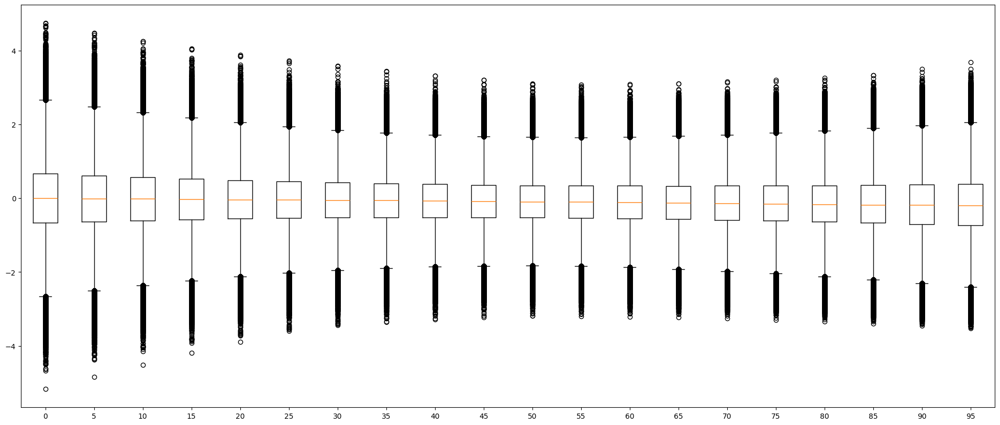

In [ ]:
plt.figure(figsize=(24, 10))
plt.boxplot([interim_activations[i].cpu().numpy().flatten() for i in list(interim_activations.keys())[::5]], vert=True, tick_labels=[int(k*100) for k in list(interim_activations.keys())[::5]])

# Conditioned Logits

In [ ]:
singer_tensor = torch.tensor(np.repeat([3], repeats=f0.shape[0])).to(audio_model.device)
samples, _, singers, (interim_activations, _, _) = audio_model.sample_cfg(f0.shape[0], f0=f0, num_steps=100, singer=singer_tensor, strength=1, invert_audio_fn=invert_audio_fn, log_interim_samples=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x7f6d65c71660>,
 'caps': [<matplotlib.lines.Line2D at 0x7f6d65c71ba0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f6d65c713c0>,
 'medians': [<matplotlib.lines.Line2D at 0x7f6d65c720e0>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f6d65c72380>,
 'means': []}

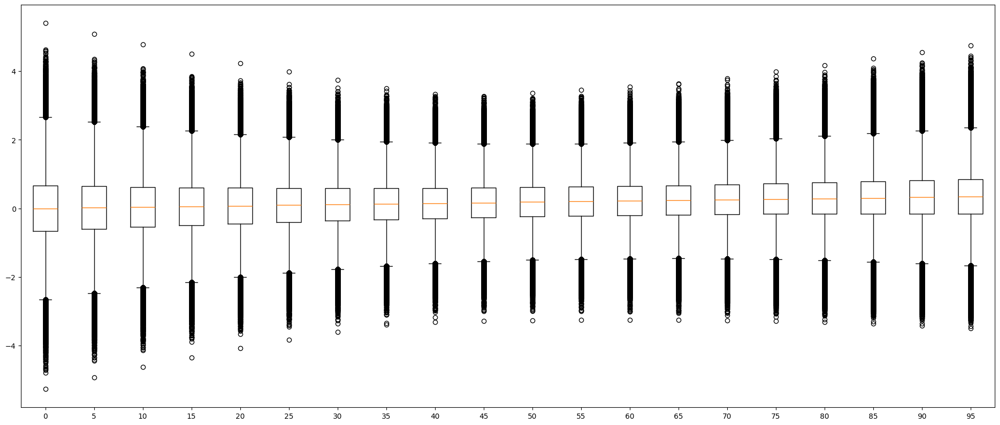

In [ ]:
plt.figure(figsize=(24, 10))
plt.boxplot([interim_activations[i].cpu().numpy().flatten() for i in list(interim_activations.keys())[::5]], vert=True, tick_labels=[int(k*100) for k in list(interim_activations.keys())[::5]])

# CFG logits

In [ ]:
singer_tensor = torch.tensor(np.repeat([3], repeats=f0.shape[0])).to(audio_model.device)
samples, _, singers, (interim_activations, _, _) = audio_model.sample_cfg(f0.shape[0], f0=f0, num_steps=100, singer=singer_tensor, strength=3, invert_audio_fn=invert_audio_fn, log_interim_samples=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x7f6d769f2b90>,
 'caps': [<matplotlib.lines.Line2D at 0x7f6d769f30d0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f6d769f28f0>,
 'medians': [<matplotlib.lines.Line2D at 0x7f6d769f3610>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f6d769f38b0>,
 'means': []}

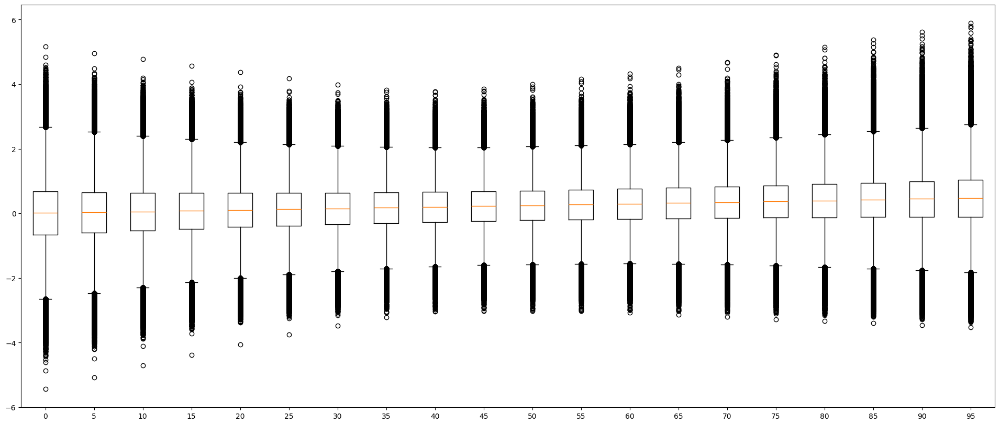

In [ ]:
plt.figure(figsize=(24, 10))
plt.boxplot([interim_activations[i].cpu().numpy().flatten() for i in list(interim_activations.keys())[::5]], vert=True, tick_labels=[int(k*100) for k in list(interim_activations.keys())[::5]])

# Log interim layer-wise activations

In [7]:
singer_tensor = torch.tensor(np.repeat([3], repeats=f0.shape[0])).to(audio_model.device)
samples, _, singers, (interim_activations, interim_layer_wise_logits, _) = audio_model.sample_cfg(f0.shape[0], f0=f0, num_steps=100, singer=singer_tensor, strength=0, invert_audio_fn=invert_audio_fn, log_interim_samples=True, log_interim_forward_activations=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x7f0418570c70>,
 'caps': [<matplotlib.lines.Line2D at 0x7f04185711b0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f04185709d0>,
 'medians': [<matplotlib.lines.Line2D at 0x7f04185716f0>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f0418571990>,
 'means': []}

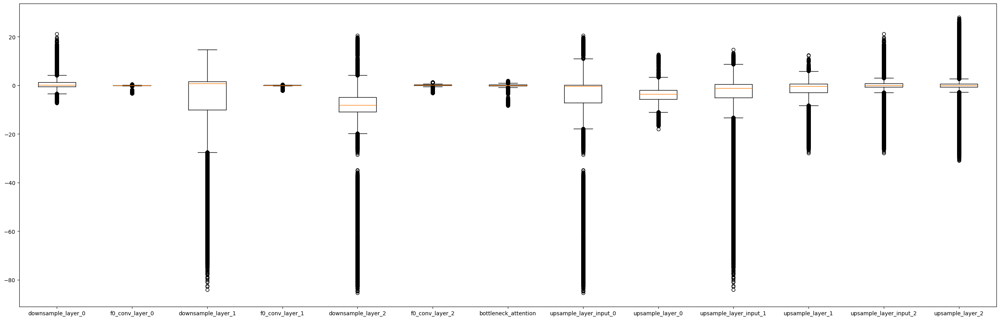

In [ ]:
plt.figure(figsize=(32, 10))
plt.boxplot([interim_layer_wise_logits[i].cpu().numpy().flatten() for i in list(interim_layer_wise_logits.keys())], vert=True, tick_labels=[k for k in list(interim_layer_wise_logits.keys())])

In [ ]:
interim_layer_wise_logits.keys()

dict_keys(['downsample_layer_0', 'f0_conv_layer_0', 'downsample_layer_1', 'f0_conv_layer_1', 'downsample_layer_2', 'f0_conv_layer_2', 'bottleneck_attention', 'upsample_layer_input_0', 'upsample_layer_0', 'upsample_layer_input_1', 'upsample_layer_1', 'upsample_layer_input_2', 'upsample_layer_2'])

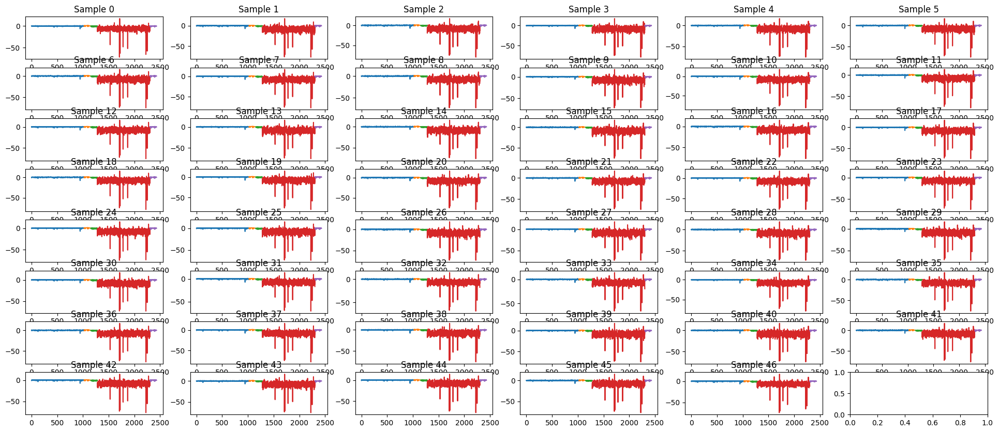

In [ ]:
fig, axs = plt.subplots(8, 6, figsize=(24, 10))
for i, ax in enumerate(axs.flatten()):
    if i < 47:
        sample = interim_layer_wise_logits['upsample_layer_input_0'][0, :, i].cpu().numpy().flatten()
        ax.plot(np.arange(1024), sample[0:1024], label='input from previous layer')
        ax.plot(np.arange(1024, 1024+128), sample[1024:1024+128], label='time conditioning')
        ax.plot(np.arange(1024+128, 1024+128+128), sample[1024+128:1024+128+128], label='singer conditioning')
        ax.plot(np.arange(1024+128+128, 1024+128+128+1024), sample[1024+128+128:1024+128+128+1024], label='skip connection output')
        ax.plot(np.arange(1024+128+128+1024, 1024+128+128+1024+128), sample[1024+128+128+1024:1024+128+128+1024+128], label='pitch conditioning')
        ax.set_title(f'Sample {i}')
    else:
        break

In [ ]:
interim_layer_wise_logits['upsample_layer_input_2'][0].shape

torch.Size([1408, 188])

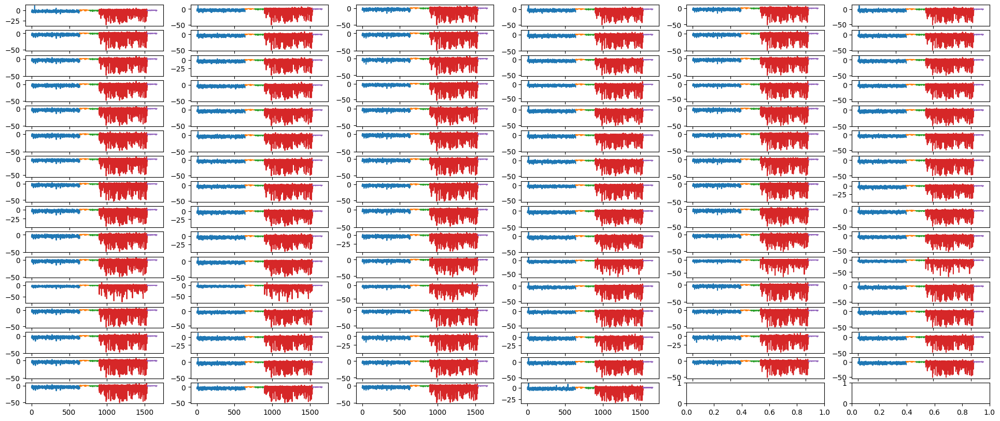

In [ ]:
fig, axs = plt.subplots(16, 6, figsize=(24, 10))
for i, ax in enumerate(axs.flatten()):
    if i < 94:
        sample = interim_layer_wise_logits['upsample_layer_input_1'][0, :, i].cpu().numpy().flatten()
        ax.plot(np.arange(640), sample[0:640], label='input from previous layer')
        ax.plot(np.arange(640, 640+128), sample[640:640+128], label='time conditioning')
        ax.plot(np.arange(640+128, 640+128+128), sample[640+128:640+128+128], label='singer conditioning')
        ax.plot(np.arange(640+128+128, 640+128+128+640), sample[640+128+128:640+128+128+640], label='skip connection output')
        ax.plot(np.arange(640+128+128+640, 640+128+128+640+128), sample[640+128+128+640:640+128+128+640+128], label='pitch conditioning')
    else:
        break

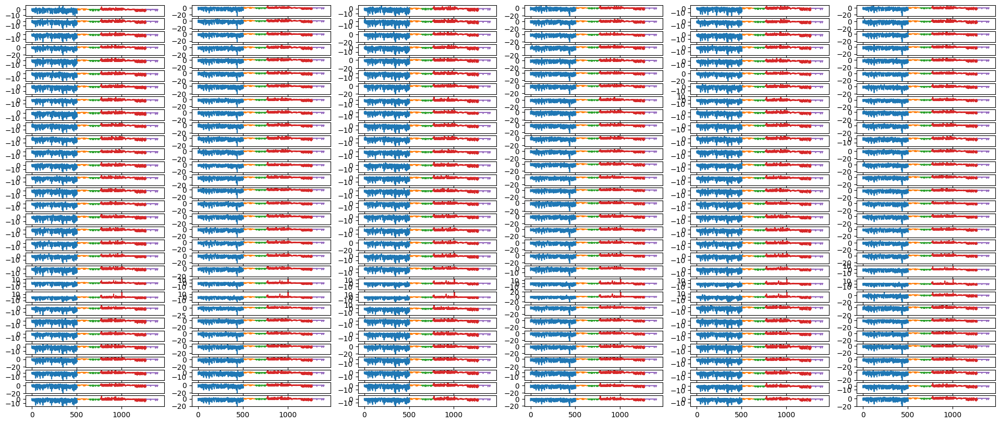

In [ ]:
fig, axs = plt.subplots(31, 6, figsize=(24, 10))
for i, ax in enumerate(axs.flatten()):
    if i < 188:
        sample = interim_layer_wise_logits['upsample_layer_input_2'][0, :, i].cpu().numpy().flatten()
        ax.plot(np.arange(512), sample[0:512], label='input from previous layer')
        ax.plot(np.arange(512, 512+128), sample[512:512+128], label='time conditioning')
        ax.plot(np.arange(512+128, 512+128+128), sample[512+128:512+128+128], label='singer conditioning')
        ax.plot(np.arange(512+128+128, 512+128+128+512), sample[512+128+128:512+128+128+512], label='skip connection output')
        ax.plot(np.arange(512+128+128+512, 512+128+128+512+128), sample[512+128+128+512:512+128+128+512+128], label='pitch conditioning')
    else:
        break

## Plot weight distribution

initial_projection.weight
singer_embedding.weight
Plotting weights for singer_embedding.weight (Fully Connected layer)


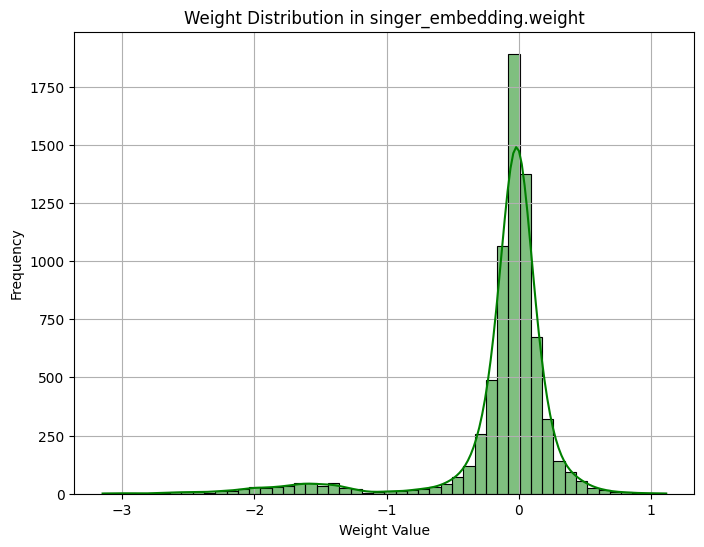

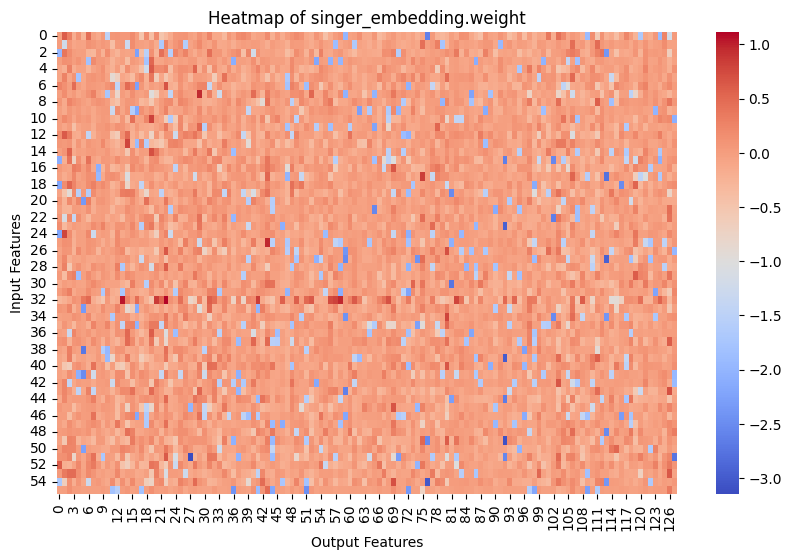

downsample_layers.0.process_layer.convs.0.conv.weight
downsample_layers.0.process_layer.convs.1.conv.weight
downsample_layers.0.process_layer.convs.2.conv.weight
downsample_layers.0.process_layer.convs.3.conv.weight
downsample_layers.1.input_layers.1.weight
downsample_layers.1.process_layer.convs.0.conv.weight
downsample_layers.1.process_layer.convs.1.conv.weight
downsample_layers.1.process_layer.convs.2.conv.weight
downsample_layers.1.process_layer.convs.3.conv.weight
downsample_layers.2.input_layers.1.weight
downsample_layers.2.process_layer.convs.0.conv.weight
downsample_layers.2.process_layer.convs.1.conv.weight
downsample_layers.2.process_layer.convs.2.conv.weight
downsample_layers.2.process_layer.convs.3.conv.weight
f0_conv_layers.0.weight
f0_conv_layers.1.weight
f0_conv_layers.2.weight
attention_layers.layers.0.0.0.weight
attention_layers.layers.0.1.to_q.weight
Plotting weights for attention_layers.layers.0.1.to_q.weight (Fully Connected layer)


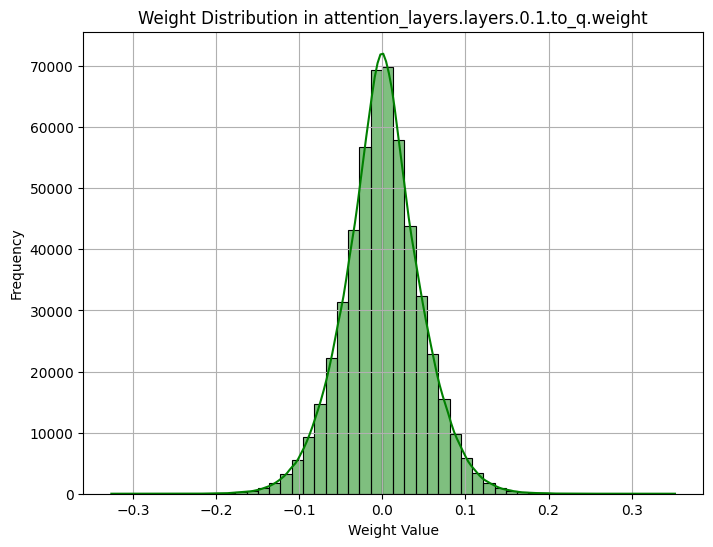

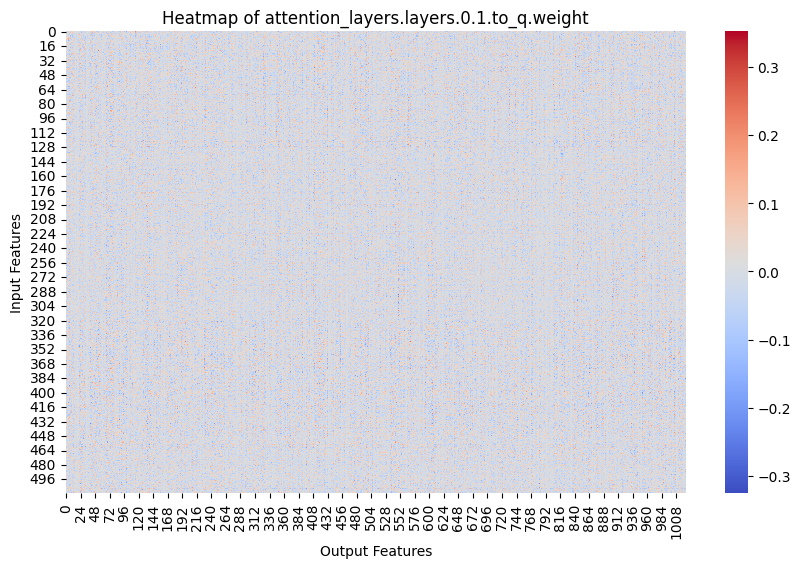

attention_layers.layers.0.1.to_k.weight
Plotting weights for attention_layers.layers.0.1.to_k.weight (Fully Connected layer)


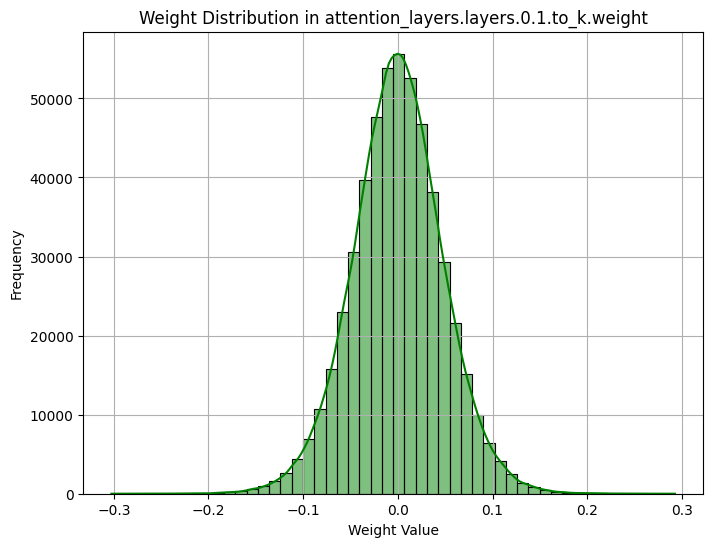

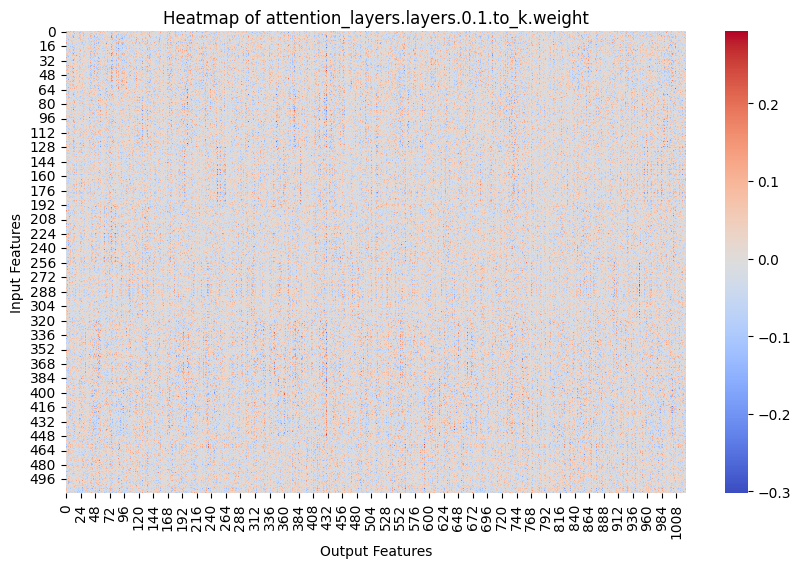

attention_layers.layers.0.1.to_v.weight
Plotting weights for attention_layers.layers.0.1.to_v.weight (Fully Connected layer)


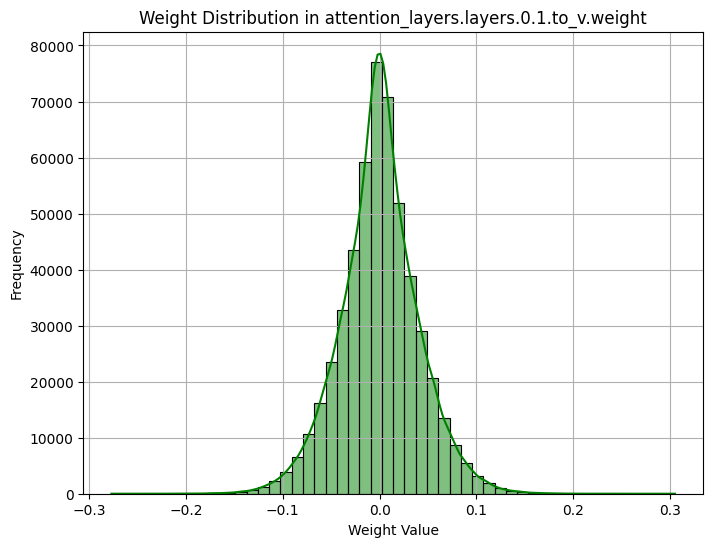

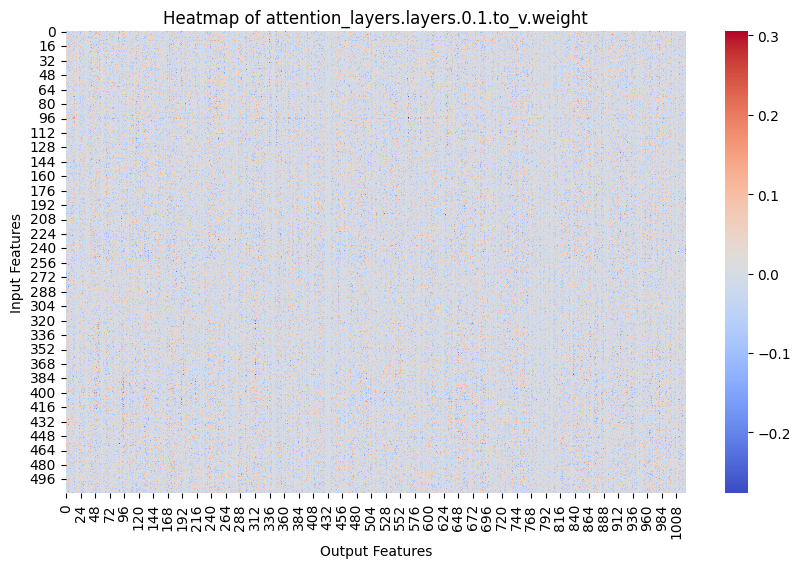

attention_layers.layers.0.1.to_out.weight
Plotting weights for attention_layers.layers.0.1.to_out.weight (Fully Connected layer)


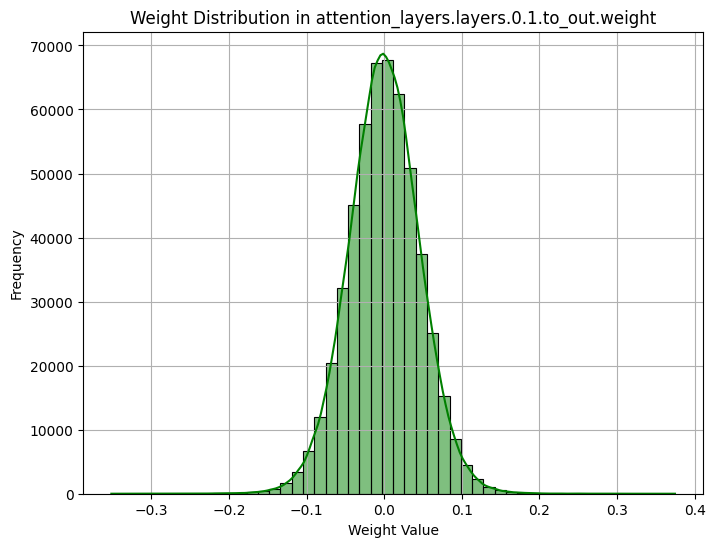

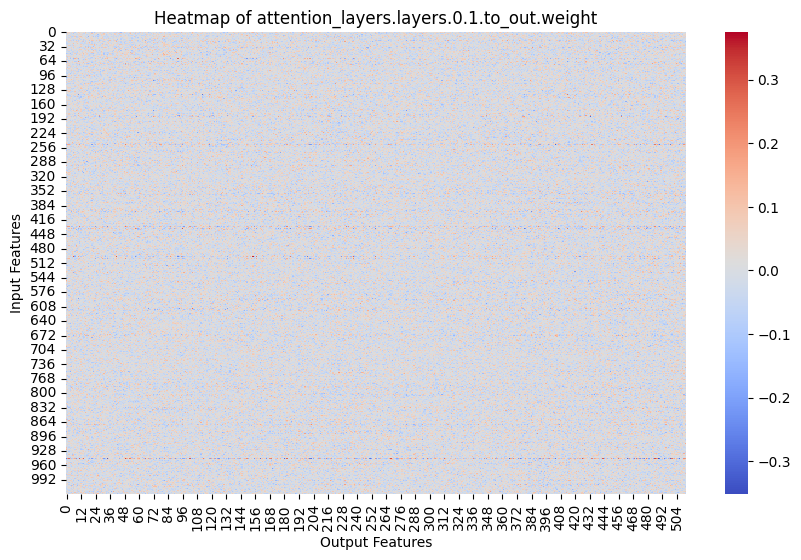

attention_layers.layers.1.0.0.weight
attention_layers.layers.1.1.ff.0.0.weight
Plotting weights for attention_layers.layers.1.1.ff.0.0.weight (Fully Connected layer)


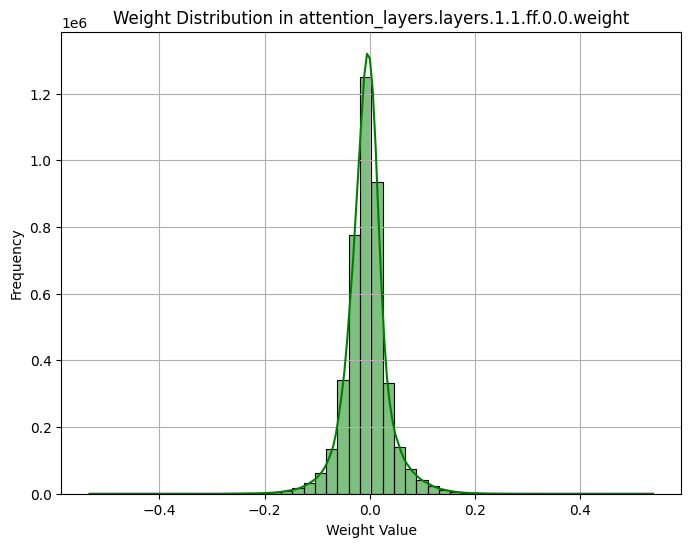

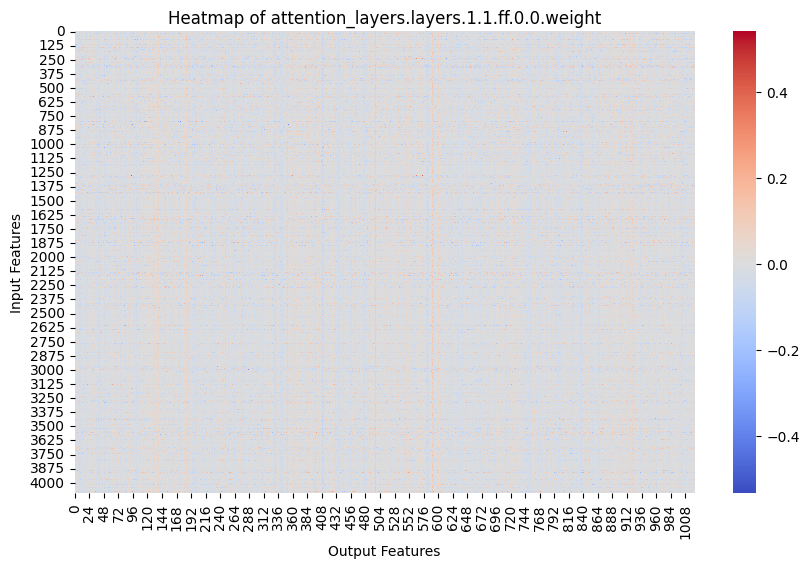

attention_layers.layers.1.1.ff.2.weight
Plotting weights for attention_layers.layers.1.1.ff.2.weight (Fully Connected layer)


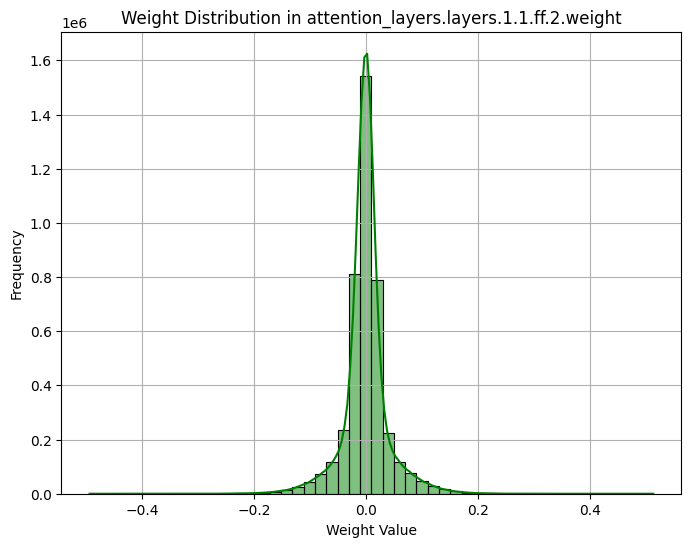

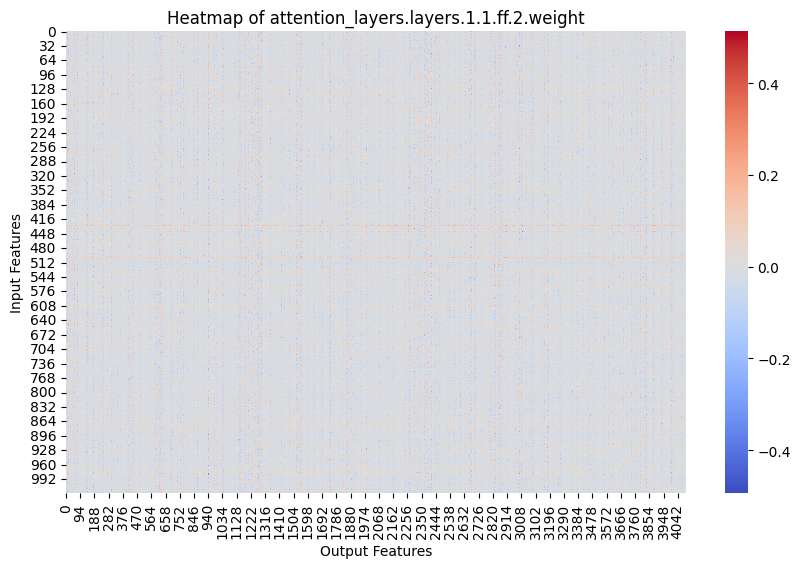

attention_layers.layers.2.0.0.weight
attention_layers.layers.2.1.to_q.weight
Plotting weights for attention_layers.layers.2.1.to_q.weight (Fully Connected layer)


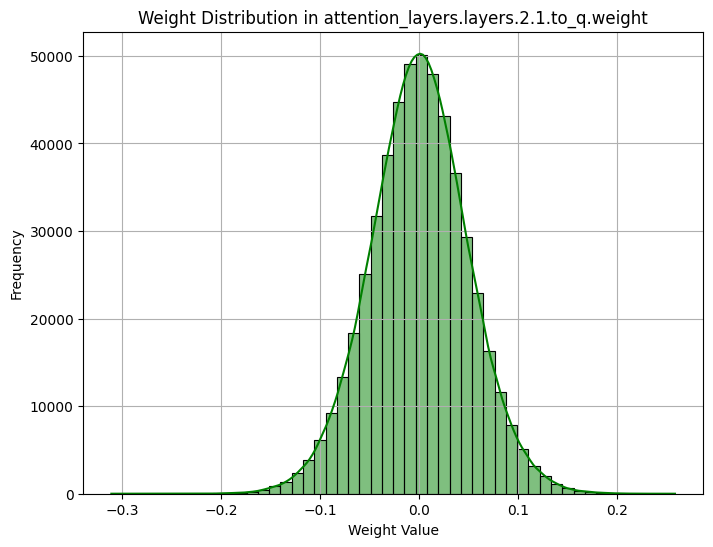

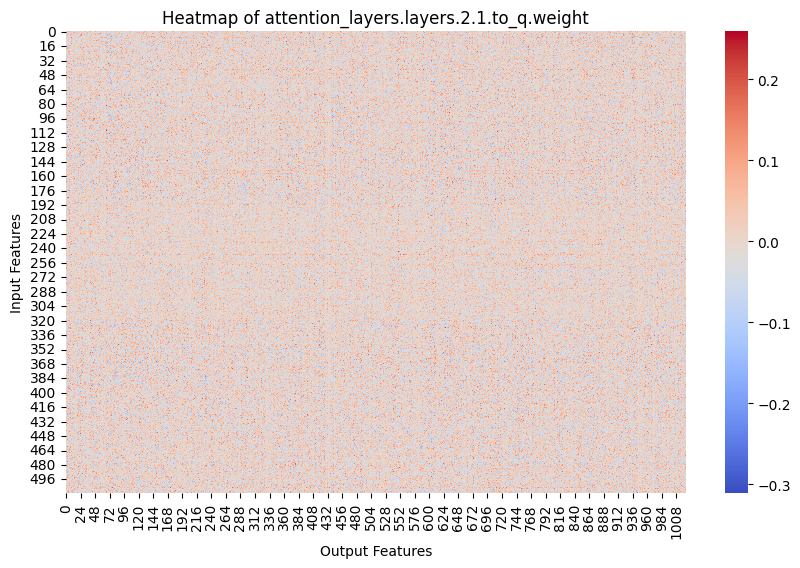

attention_layers.layers.2.1.to_k.weight
Plotting weights for attention_layers.layers.2.1.to_k.weight (Fully Connected layer)


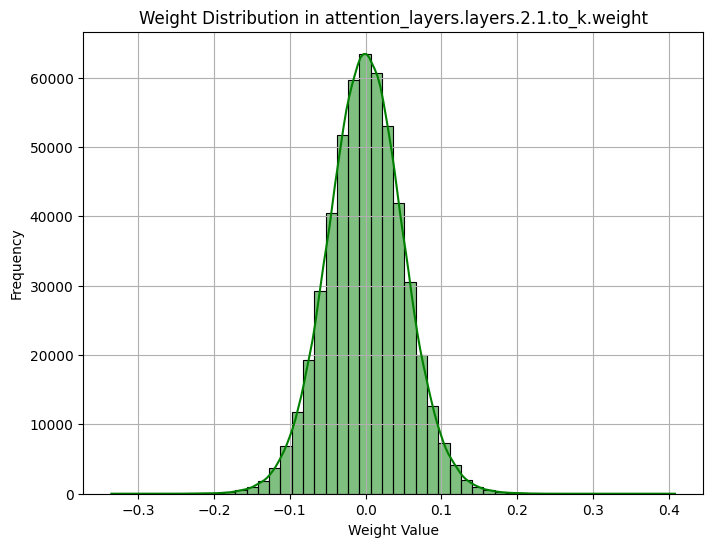

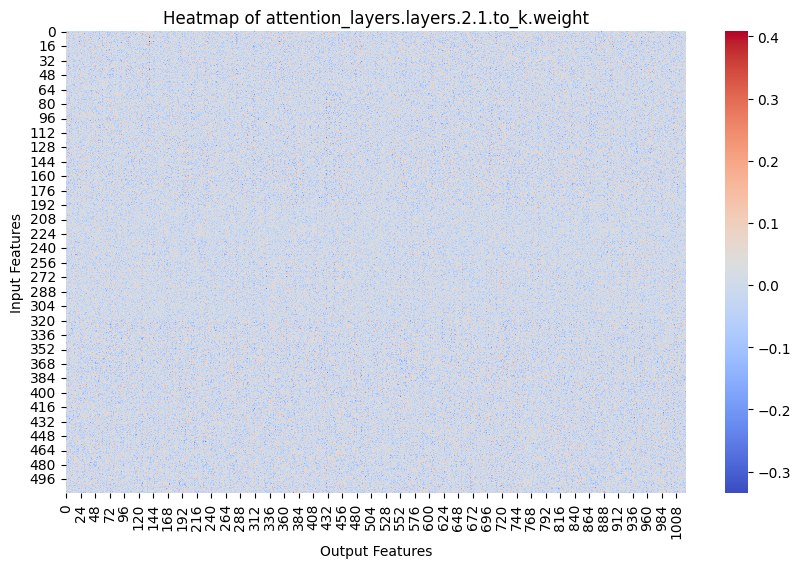

attention_layers.layers.2.1.to_v.weight
Plotting weights for attention_layers.layers.2.1.to_v.weight (Fully Connected layer)


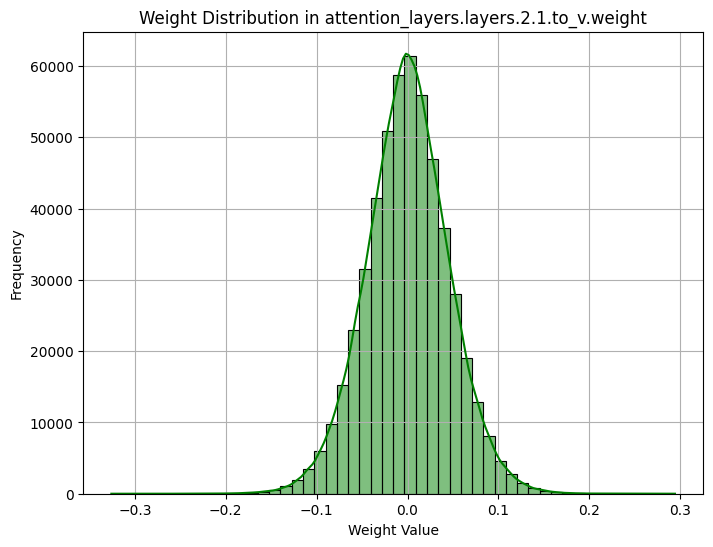

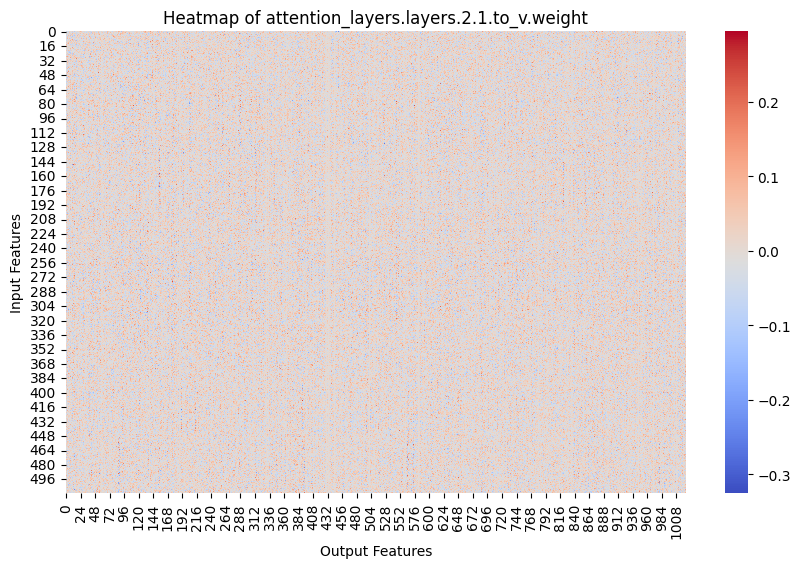

attention_layers.layers.2.1.to_out.weight
Plotting weights for attention_layers.layers.2.1.to_out.weight (Fully Connected layer)


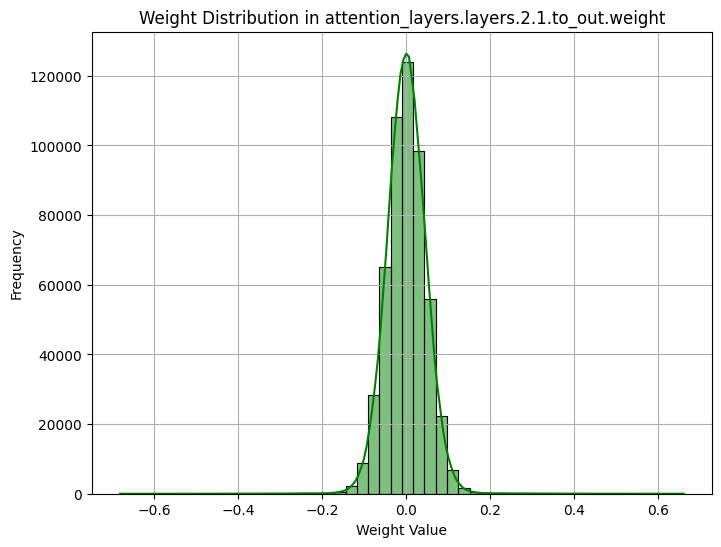

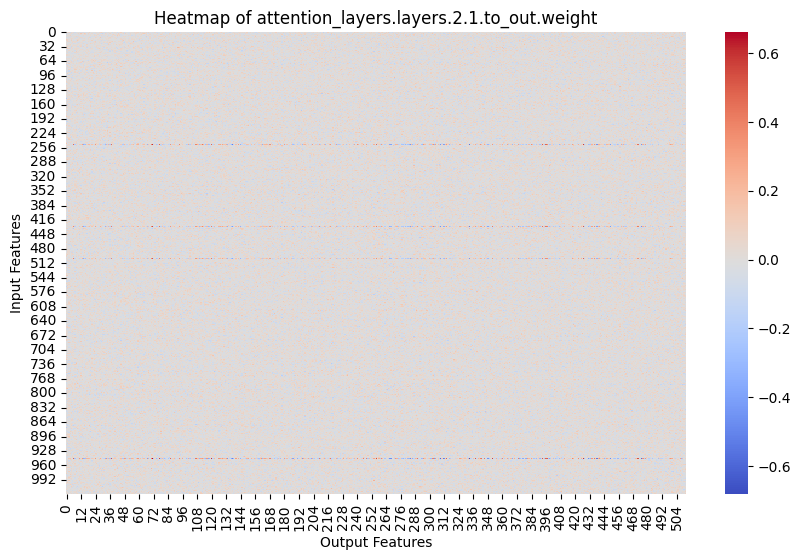

attention_layers.layers.3.0.0.weight
attention_layers.layers.3.1.ff.0.0.weight
Plotting weights for attention_layers.layers.3.1.ff.0.0.weight (Fully Connected layer)


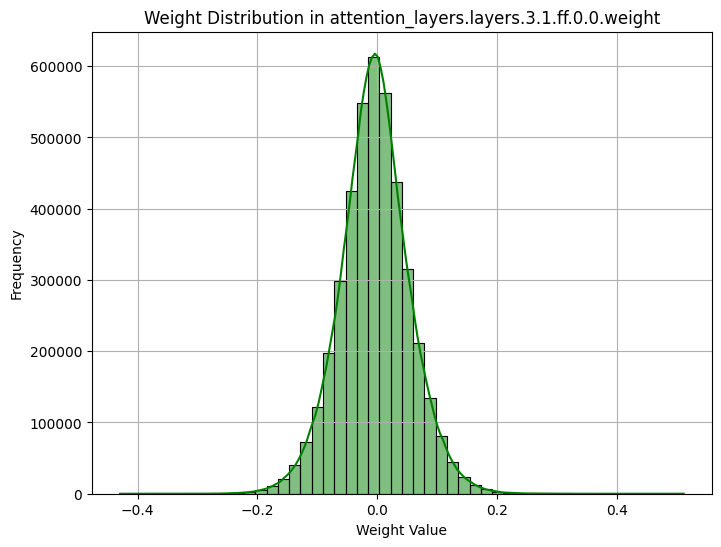

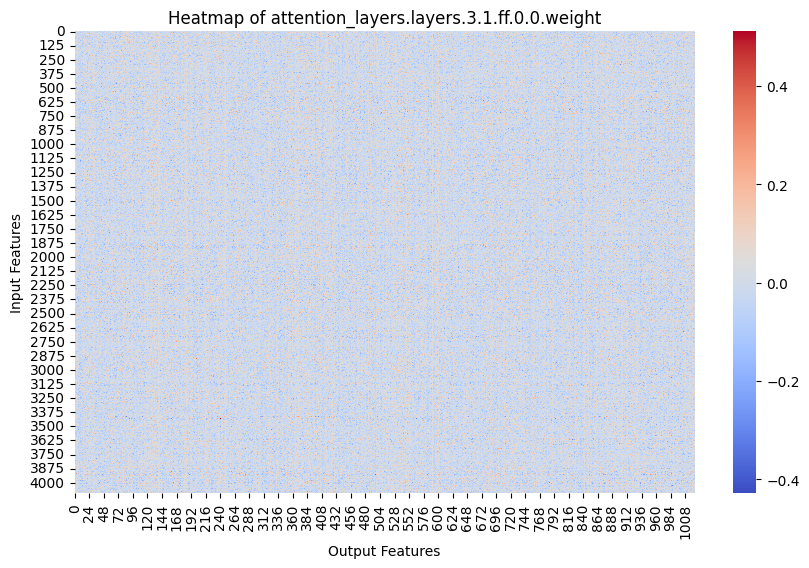

attention_layers.layers.3.1.ff.2.weight
Plotting weights for attention_layers.layers.3.1.ff.2.weight (Fully Connected layer)


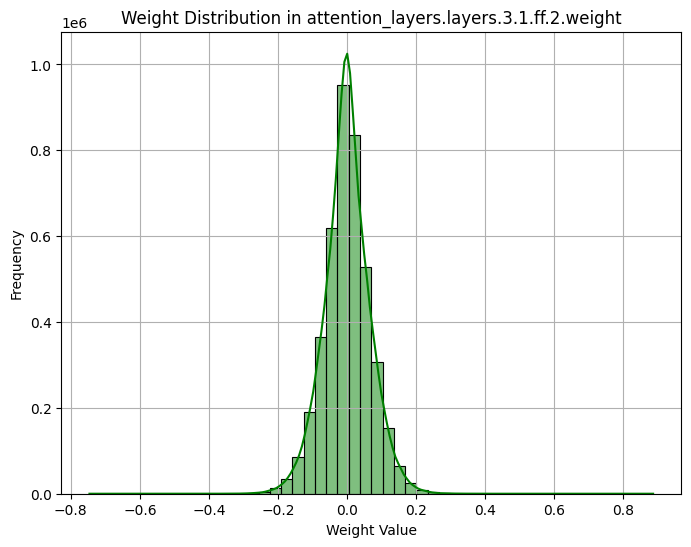

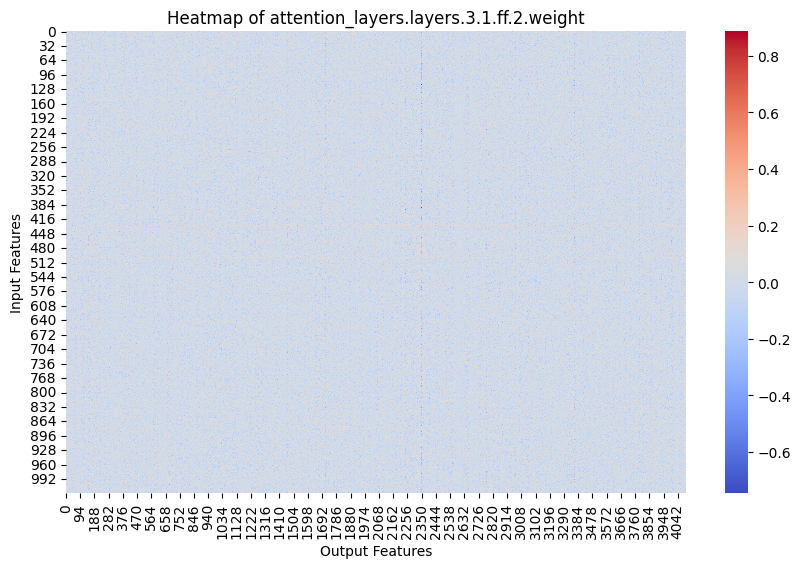

attention_layers.layers.4.0.0.weight
attention_layers.layers.4.1.to_q.weight
Plotting weights for attention_layers.layers.4.1.to_q.weight (Fully Connected layer)


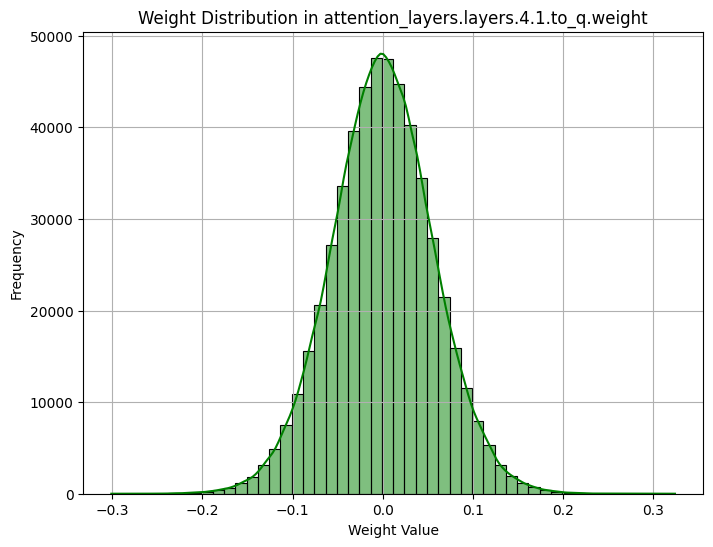

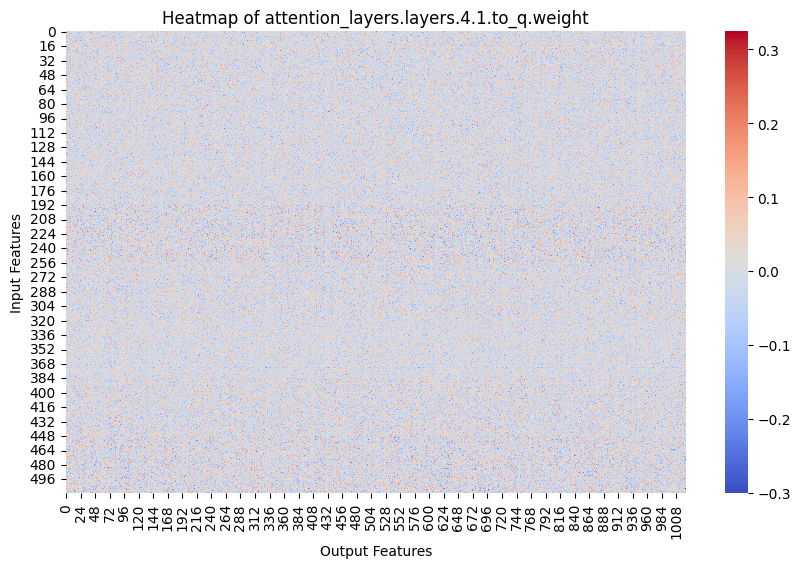

attention_layers.layers.4.1.to_k.weight
Plotting weights for attention_layers.layers.4.1.to_k.weight (Fully Connected layer)


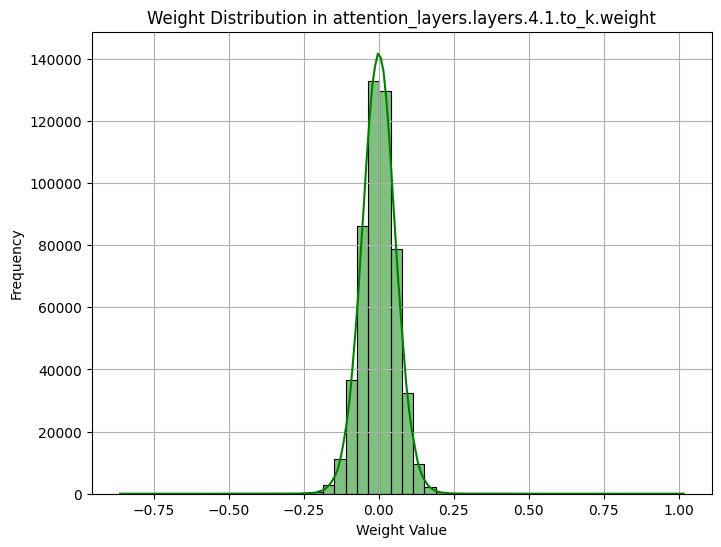

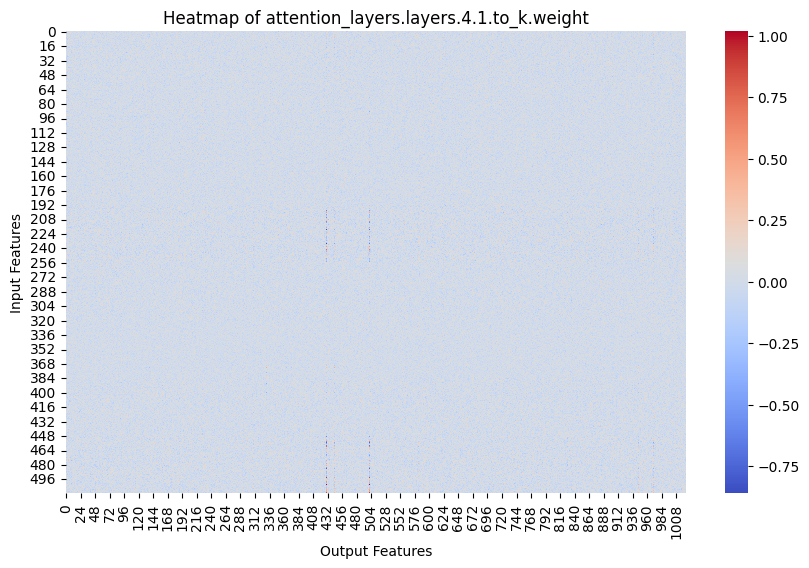

attention_layers.layers.4.1.to_v.weight
Plotting weights for attention_layers.layers.4.1.to_v.weight (Fully Connected layer)


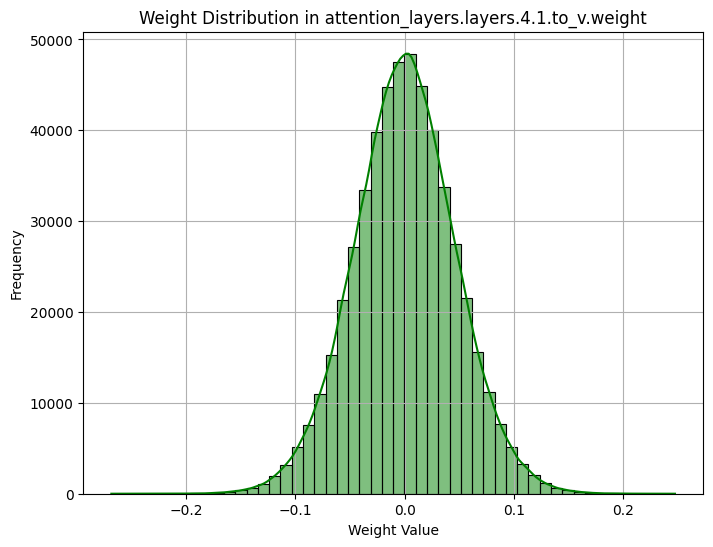

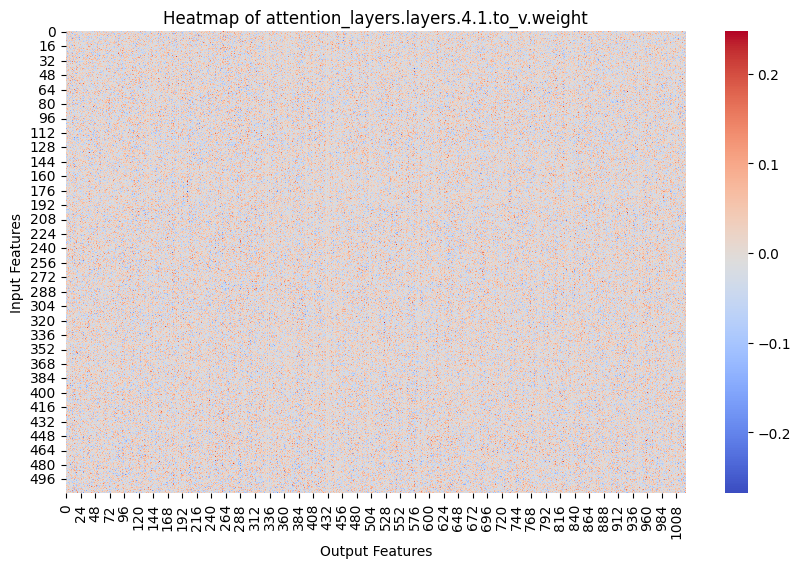

attention_layers.layers.4.1.to_out.weight
Plotting weights for attention_layers.layers.4.1.to_out.weight (Fully Connected layer)


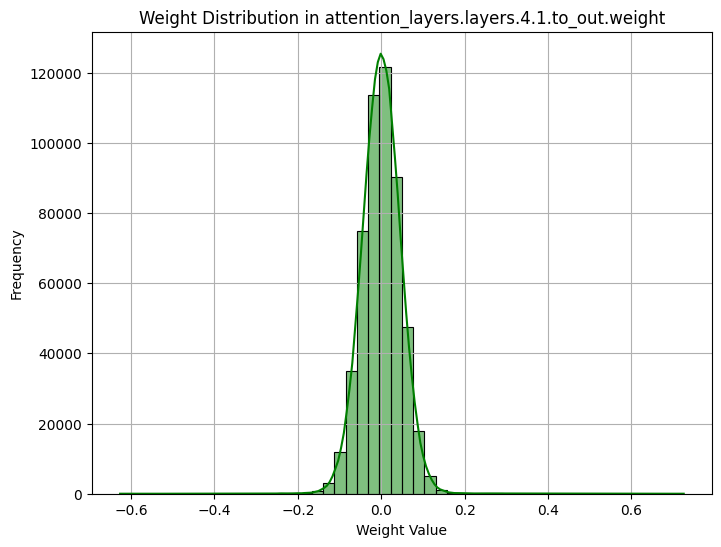

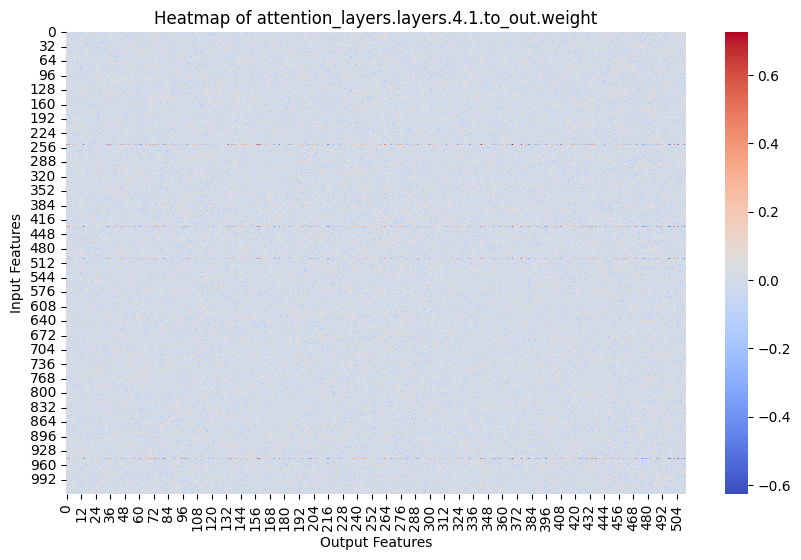

attention_layers.layers.5.0.0.weight
attention_layers.layers.5.1.ff.0.0.weight
Plotting weights for attention_layers.layers.5.1.ff.0.0.weight (Fully Connected layer)


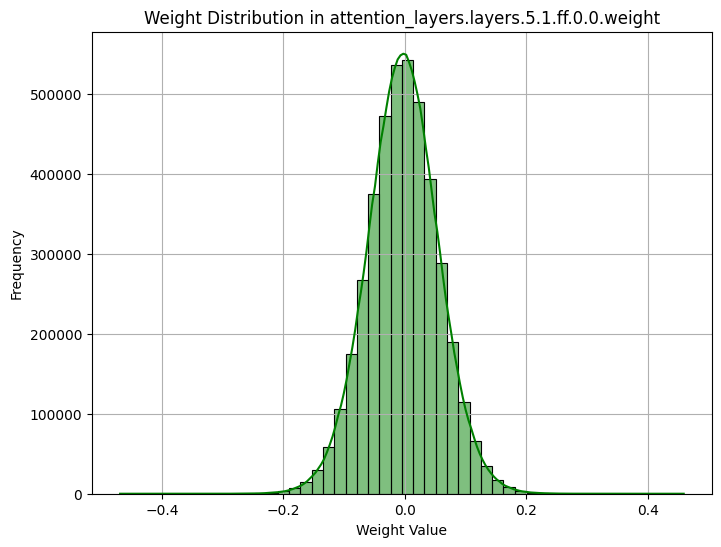

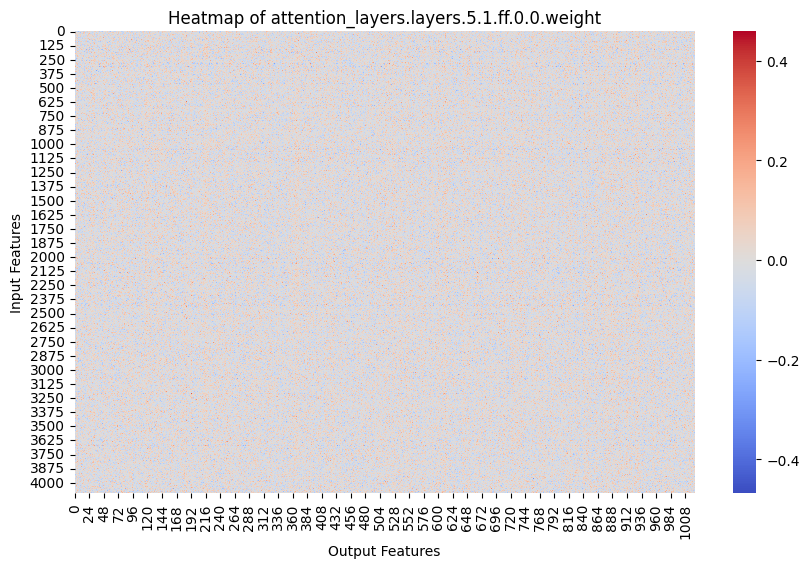

attention_layers.layers.5.1.ff.2.weight
Plotting weights for attention_layers.layers.5.1.ff.2.weight (Fully Connected layer)


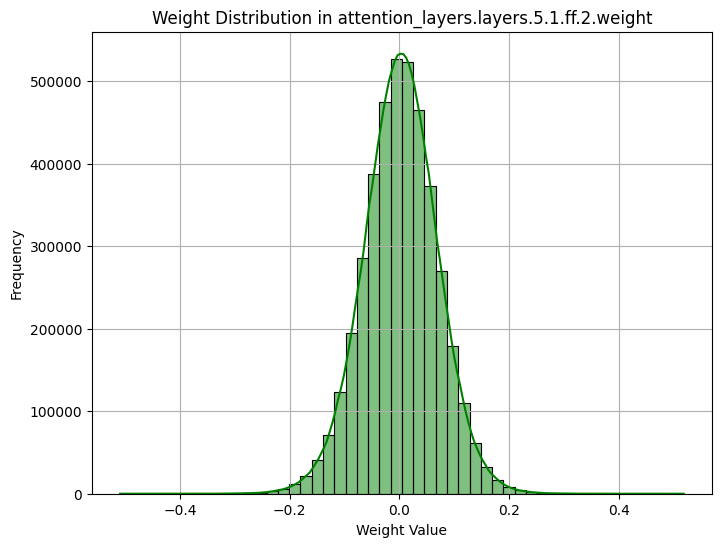

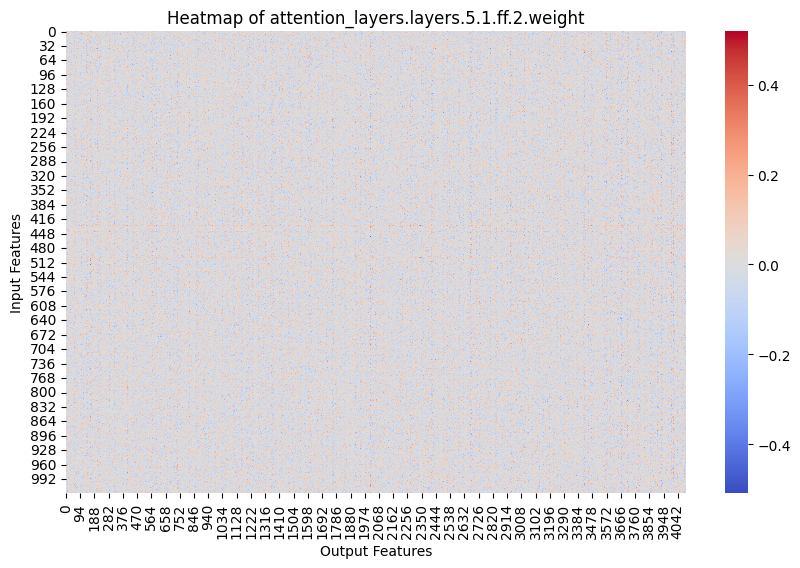

attention_layers.layers.6.0.0.weight
attention_layers.layers.6.1.to_q.weight
Plotting weights for attention_layers.layers.6.1.to_q.weight (Fully Connected layer)


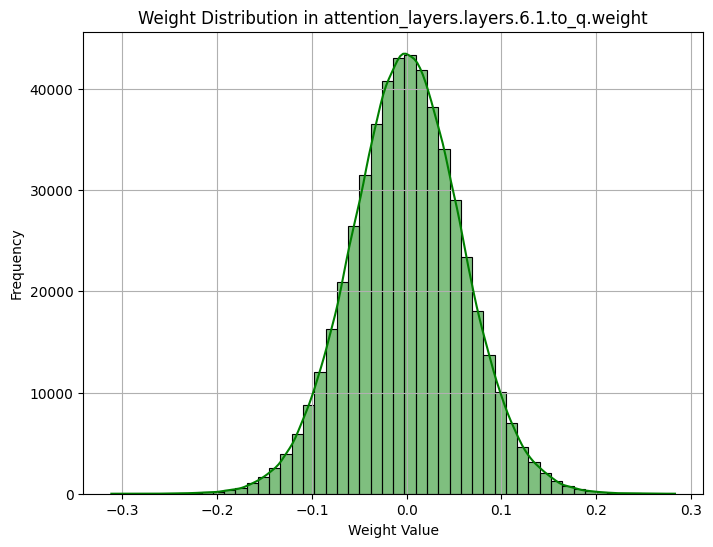

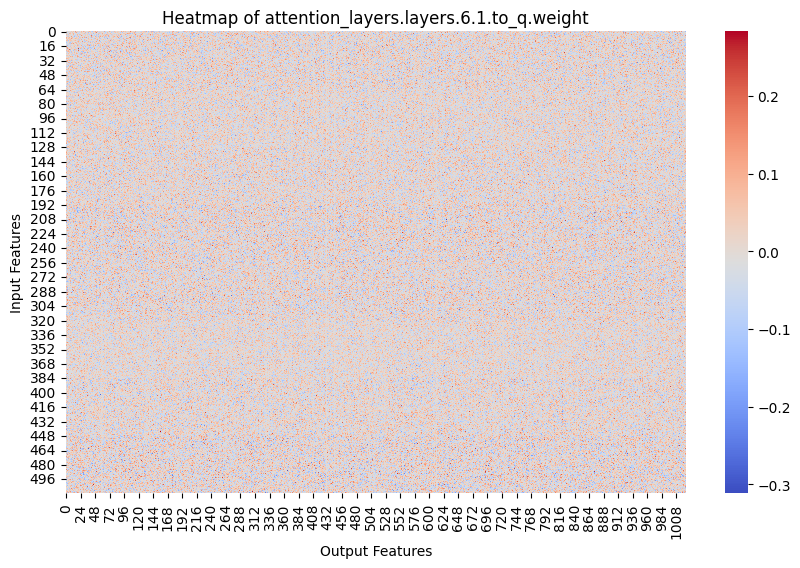

attention_layers.layers.6.1.to_k.weight
Plotting weights for attention_layers.layers.6.1.to_k.weight (Fully Connected layer)


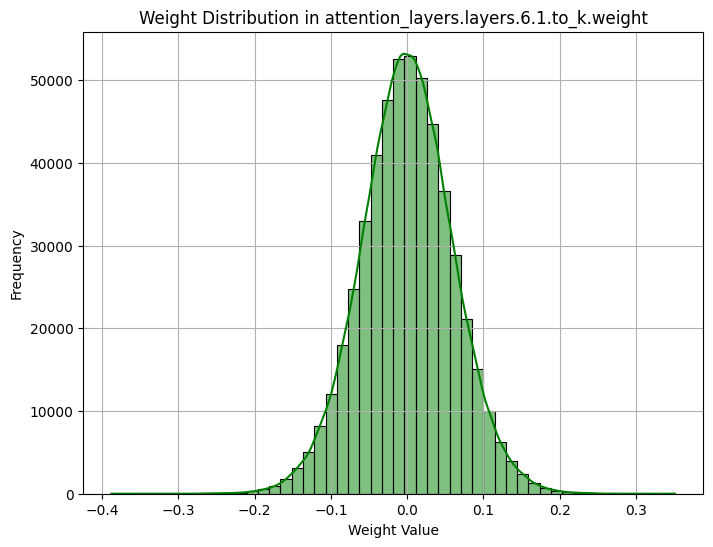

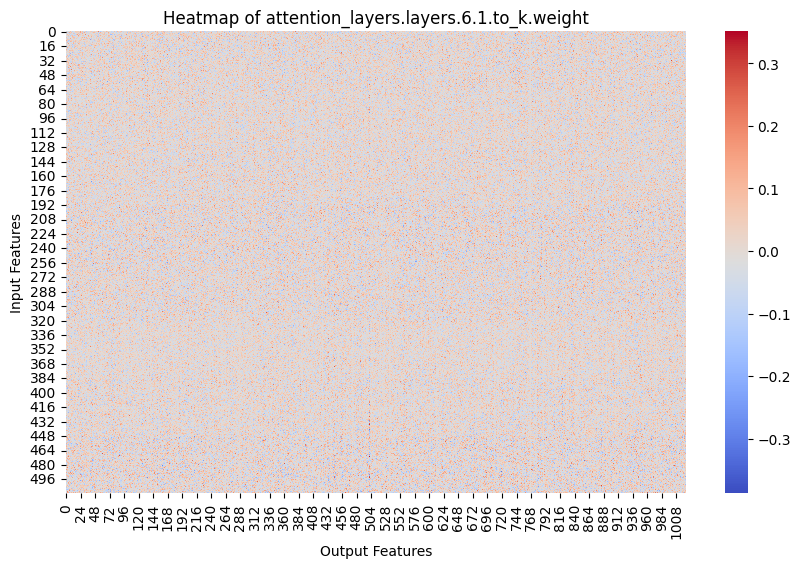

attention_layers.layers.6.1.to_v.weight
Plotting weights for attention_layers.layers.6.1.to_v.weight (Fully Connected layer)


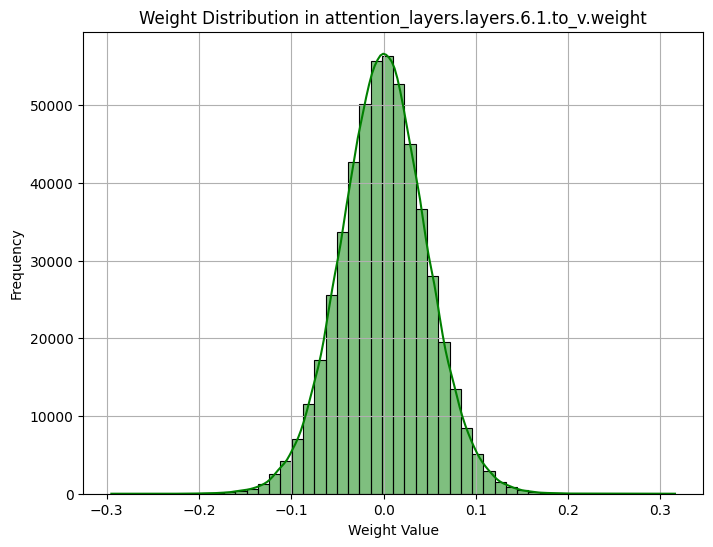

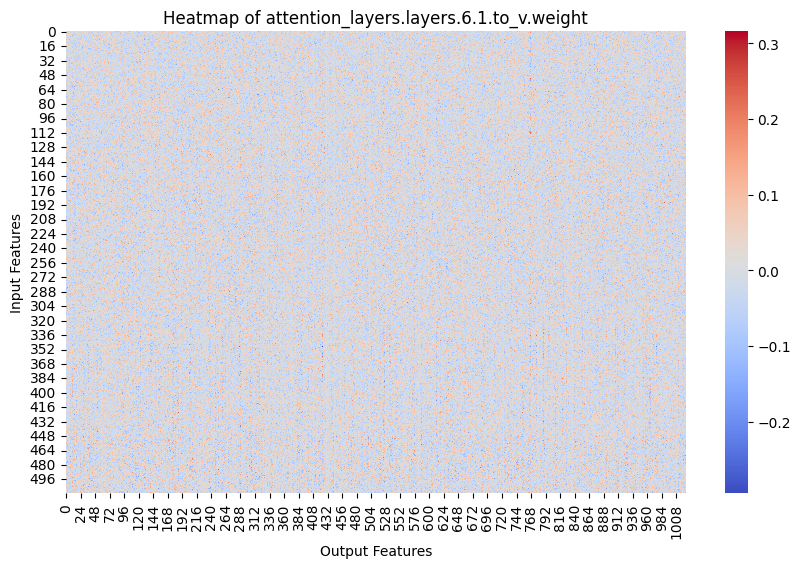

attention_layers.layers.6.1.to_out.weight
Plotting weights for attention_layers.layers.6.1.to_out.weight (Fully Connected layer)


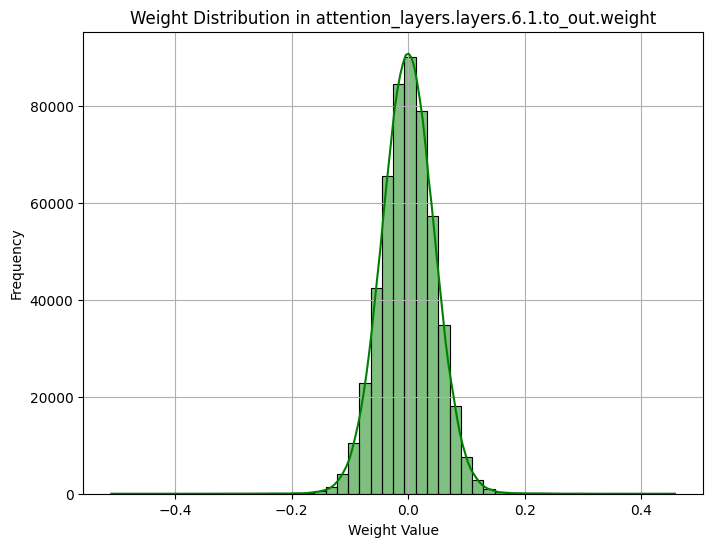

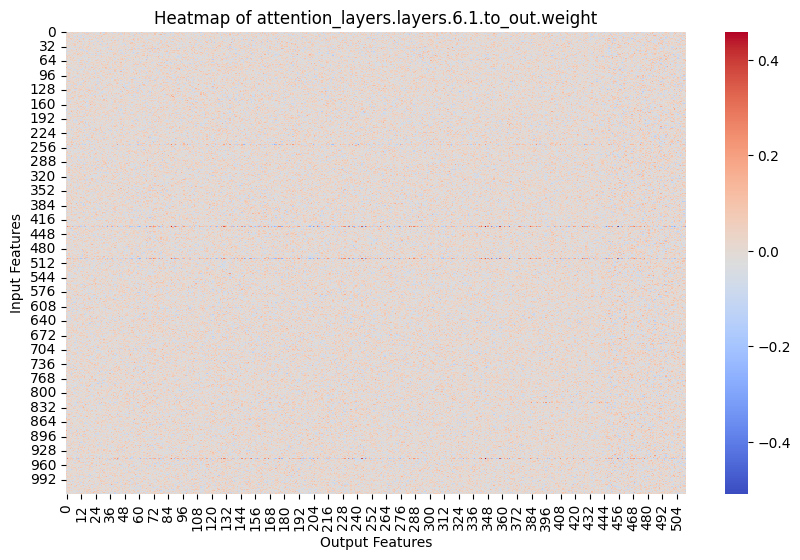

attention_layers.layers.7.0.0.weight
attention_layers.layers.7.1.ff.0.0.weight
Plotting weights for attention_layers.layers.7.1.ff.0.0.weight (Fully Connected layer)


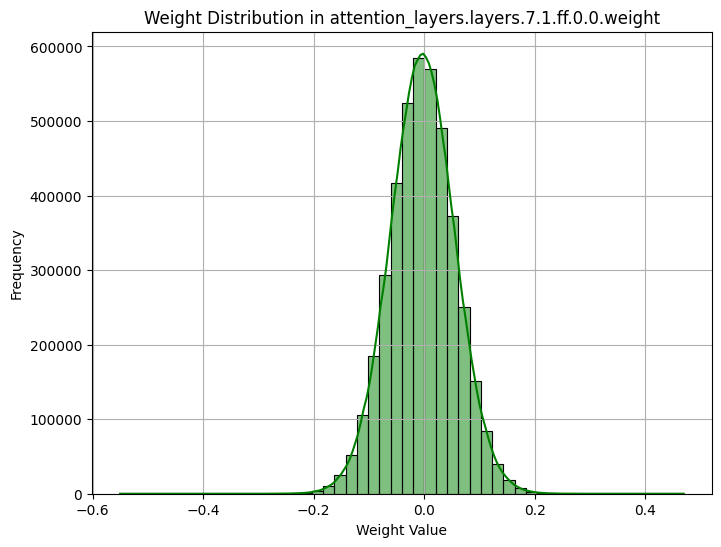

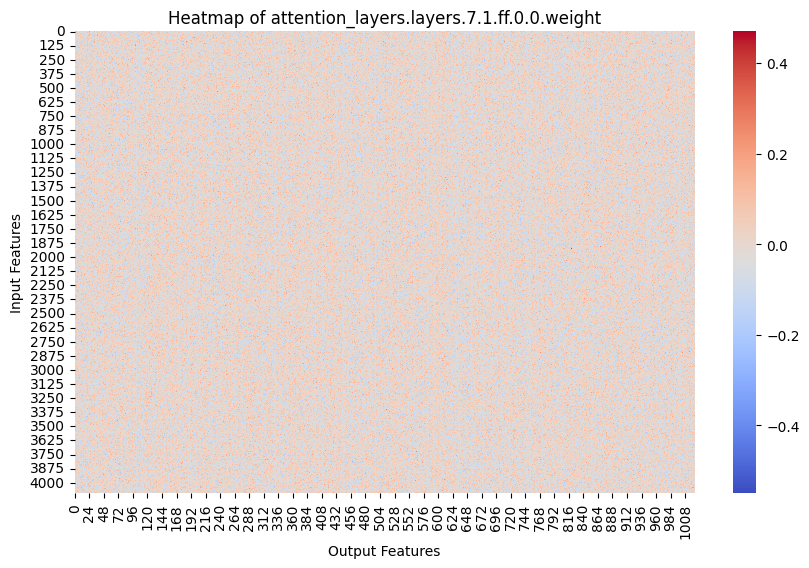

attention_layers.layers.7.1.ff.2.weight
Plotting weights for attention_layers.layers.7.1.ff.2.weight (Fully Connected layer)


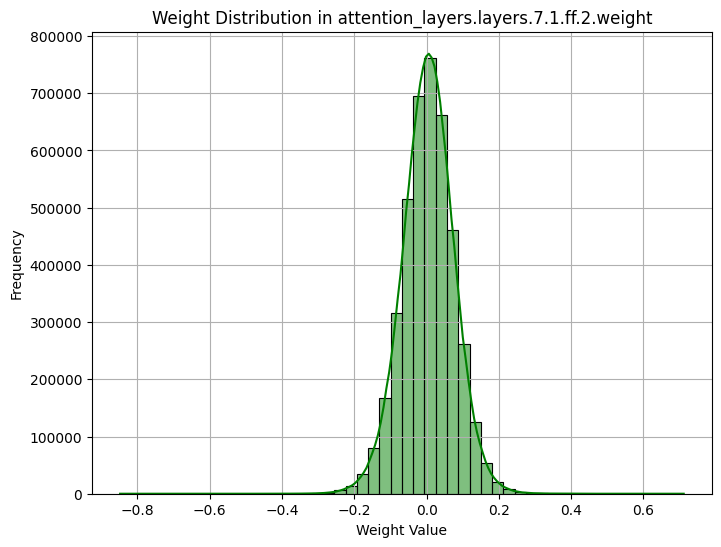

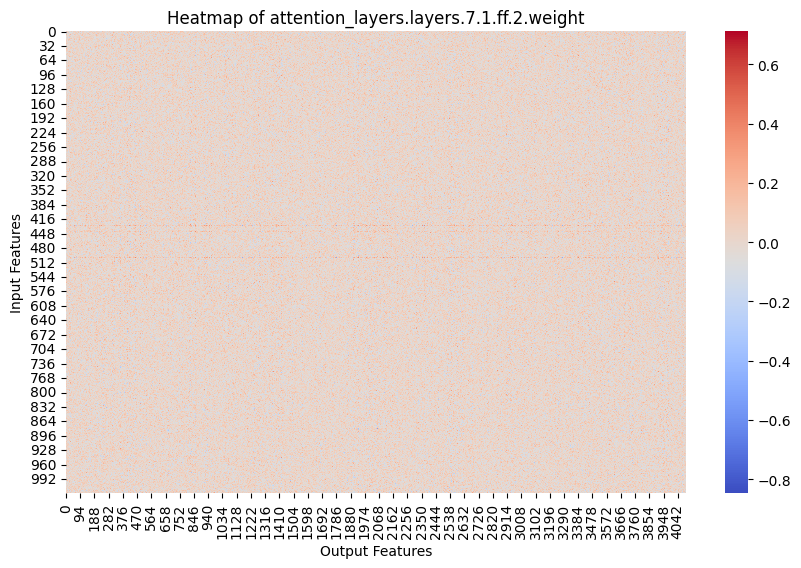

attention_layers.final_norm.weight
upsample_layers.0.input_layers.1.weight
upsample_layers.0.process_layer.convs.0.conv.weight
upsample_layers.0.process_layer.convs.1.conv.weight
upsample_layers.0.process_layer.convs.2.conv.weight
upsample_layers.0.process_layer.convs.3.conv.weight
upsample_layers.1.input_layers.1.weight
upsample_layers.1.process_layer.convs.0.conv.weight
upsample_layers.1.process_layer.convs.1.conv.weight
upsample_layers.1.process_layer.convs.2.conv.weight
upsample_layers.1.process_layer.convs.3.conv.weight
upsample_layers.2.input_layers.1.weight
upsample_layers.2.process_layer.convs.0.conv.weight
upsample_layers.2.process_layer.convs.1.conv.weight
upsample_layers.2.process_layer.convs.2.conv.weight
upsample_layers.2.process_layer.convs.3.conv.weight
final_projection.weight


In [ ]:
import seaborn as sns
for name, param in audio_model.named_parameters():
    if "weight" in name:  # Focus only on weights
        print(name)
        weights = param.data.cpu().numpy()

        if len(weights.shape) == 4:  # CNN layers
            print(f"Plotting weights for {name} (Convolutional layer)")

            # Plot histogram of weights
            plt.figure(figsize=(8, 6))
            sns.histplot(weights.flatten(), bins=50, kde=True, color="blue")
            plt.title(f"Weight Distribution in {name}")
            plt.xlabel("Weight Value")
            plt.ylabel("Frequency")
            plt.grid(True)
            plt.show()

            # Visualize the first filter (kernel) of the first output channel
            first_filter = weights[0, 0]  # [out_channel=0, in_channel=0]
            plt.figure(figsize=(6, 6))
            plt.imshow(first_filter, cmap="viridis", interpolation="nearest")
            plt.title(f"First Kernel in {name}")
            plt.colorbar()
            plt.show()

        elif len(weights.shape) == 2:  # Fully connected layers
            print(f"Plotting weights for {name} (Fully Connected layer)")

            # Plot histogram of weights
            plt.figure(figsize=(8, 6))
            sns.histplot(weights.flatten(), bins=50, kde=True, color="green")
            plt.title(f"Weight Distribution in {name}")
            plt.xlabel("Weight Value")
            plt.ylabel("Frequency")
            plt.grid(True)
            plt.show()

            # Plot as heatmap if weights are 2D
            plt.figure(figsize=(10, 6))
            sns.heatmap(weights, cmap="coolwarm", annot=False, cbar=True)
            plt.title(f"Heatmap of {name}")
            plt.xlabel("Output Features")
            plt.ylabel("Input Features")
            plt.show()

In [8]:
for name, param in audio_model.named_parameters():
    if len(weights.shape) == 3:  # 1D CNN layers
        print(f"Plotting weights for {name} (1D Convolutional layer)")

        # Plot histogram of weights
        plt.figure(figsize=(8, 6))
        sns.histplot(weights.flatten(), bins=50, kde=True, color="blue")
        plt.title(f"Weight Distribution in {name}")
        plt.xlabel("Weight Value")
        plt.ylabel("Frequency")
        plt.grid(True)
        plt.show()

        # Visualize the first kernel (as a line plot)
        first_kernel = weights[0, 0]  # First kernel, first input channel
        plt.figure(figsize=(8, 4))
        plt.plot(first_kernel, marker="o", linestyle="-", color="green")
        plt.title(f"First Kernel in {name} (Line Plot)")
        plt.xlabel("Kernel Index")
        plt.ylabel("Weight Value")
        plt.grid(True)
        plt.show()

        # Optional: Heatmap of all kernels for one output channel
        plt.figure(figsize=(10, 6))
        sns.heatmap(weights[0], cmap="viridis", annot=False, cbar=True)
        plt.title(f"Heatmap of Kernels in {name} (Output Channel 0)")
        plt.xlabel("Kernel Width")
        plt.ylabel("Input Channels")
        plt.show()

NameError: name 'weights' is not defined

Plotting average weights for upsample_layers.0.input_layers.1.weight: Shape (2432, 640)
Plotting average weights for upsample_layers.0.process_layer.convs.0.conv.weight: Shape (2432, 640)
Plotting average weights for upsample_layers.0.process_layer.convs.1.conv.weight: Shape (640, 640)
Plotting average weights for upsample_layers.0.process_layer.convs.2.conv.weight: Shape (640, 640)
Plotting average weights for upsample_layers.0.process_layer.convs.3.conv.weight: Shape (640, 640)
Plotting average weights for upsample_layers.1.input_layers.1.weight: Shape (1664, 512)
Plotting average weights for upsample_layers.1.process_layer.convs.0.conv.weight: Shape (1664, 512)
Plotting average weights for upsample_layers.1.process_layer.convs.1.conv.weight: Shape (512, 512)
Plotting average weights for upsample_layers.1.process_layer.convs.2.conv.weight: Shape (512, 512)
Plotting average weights for upsample_layers.1.process_layer.convs.3.conv.weight: Shape (512, 512)
Plotting average weights for u

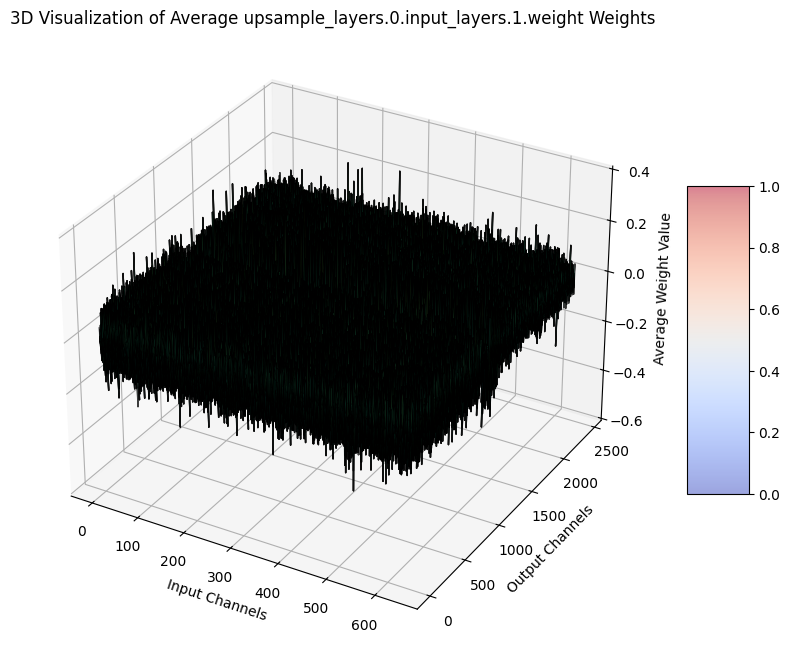

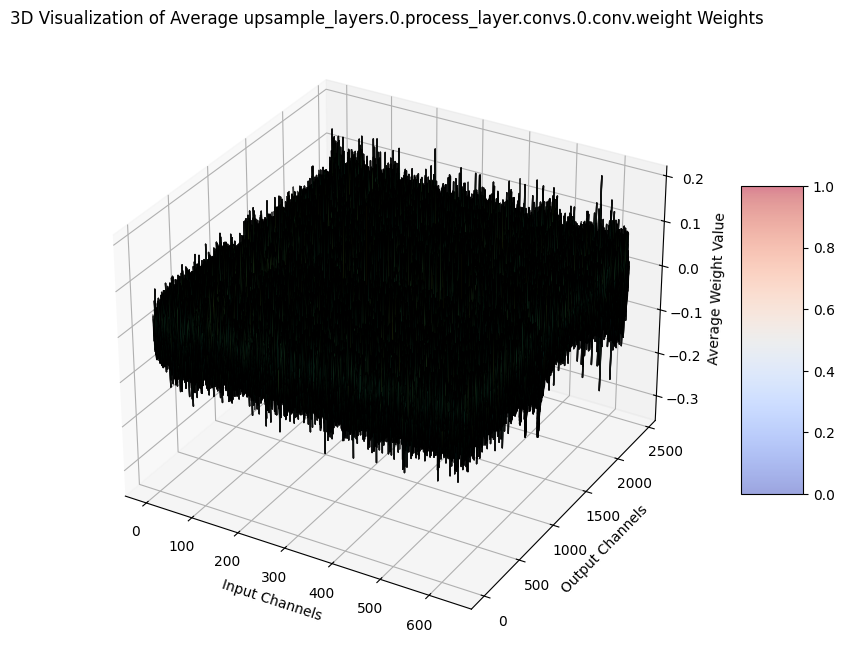

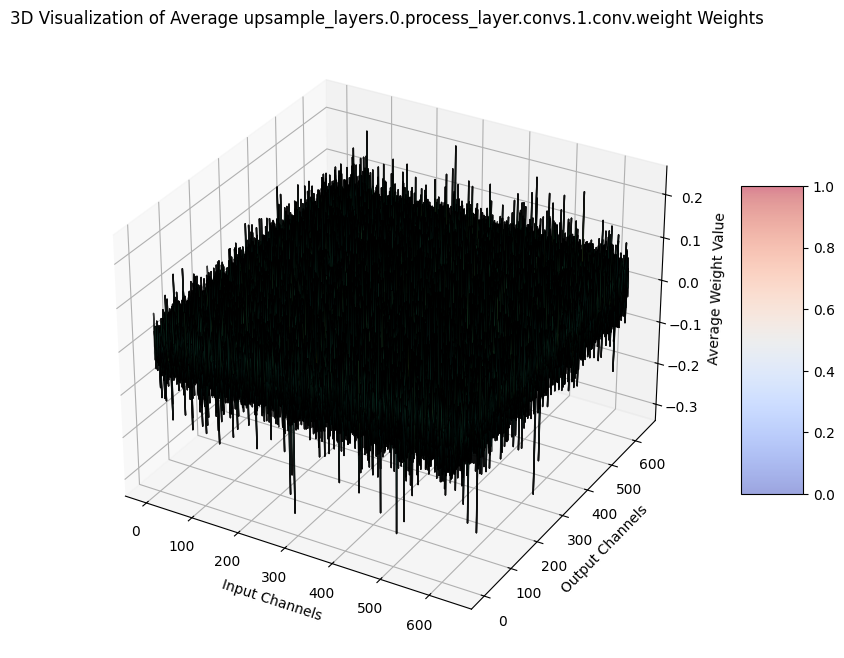

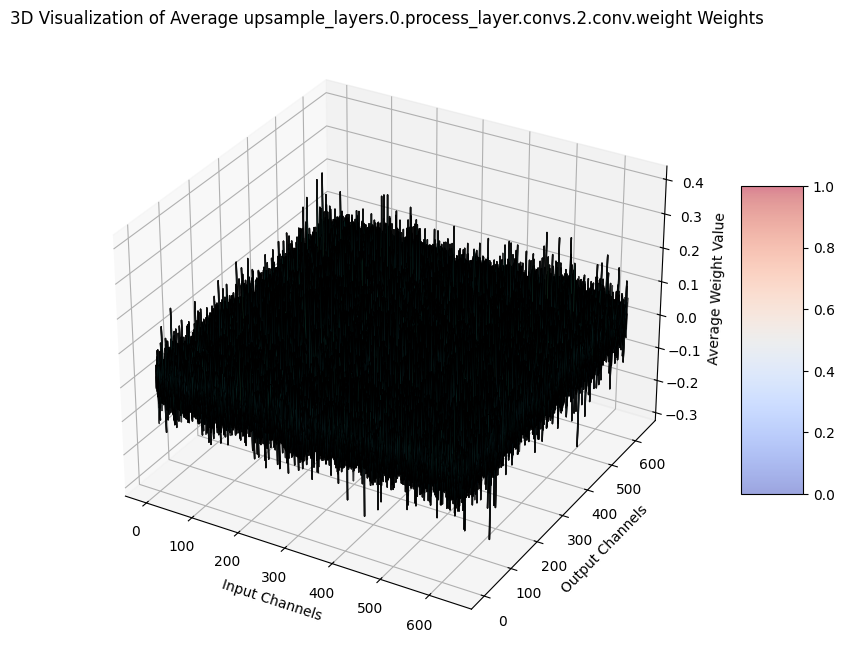

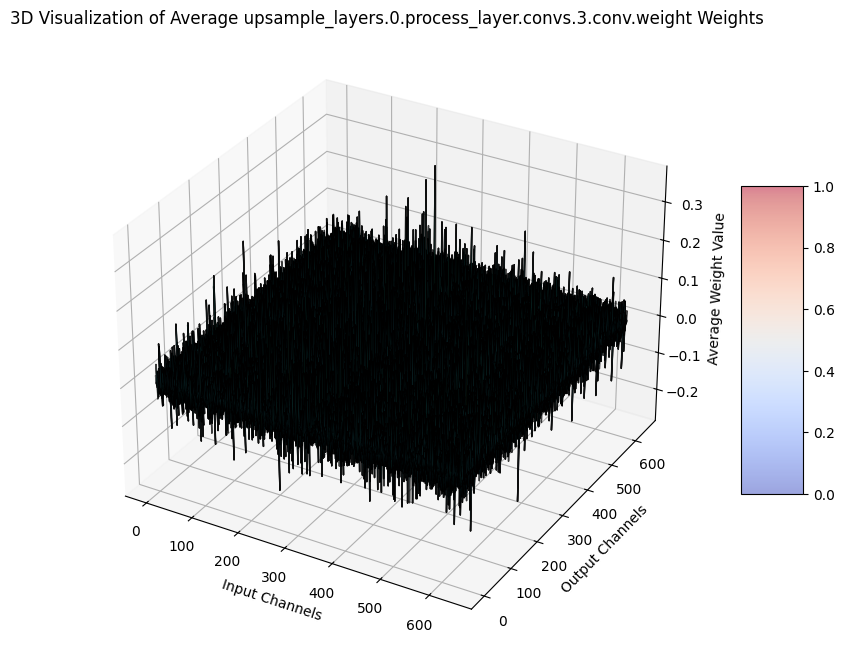

...

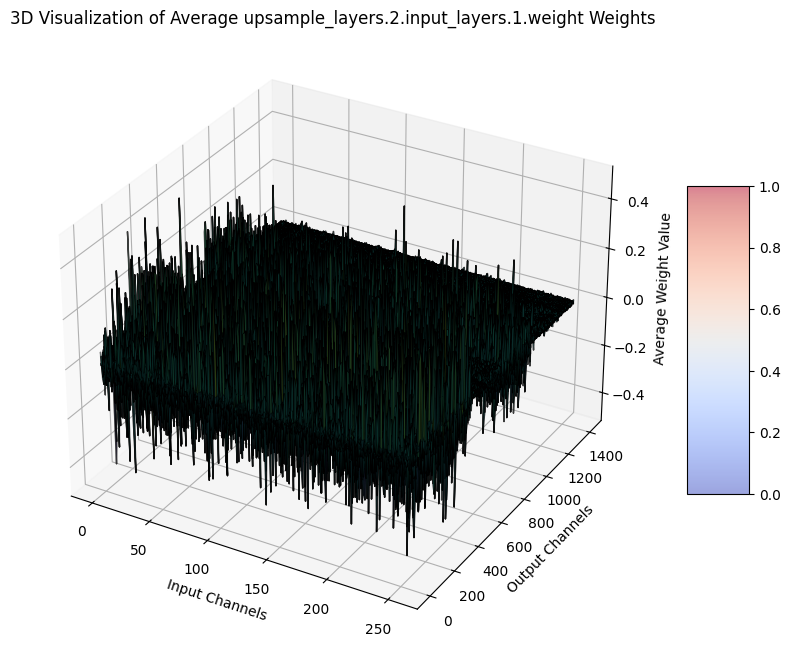

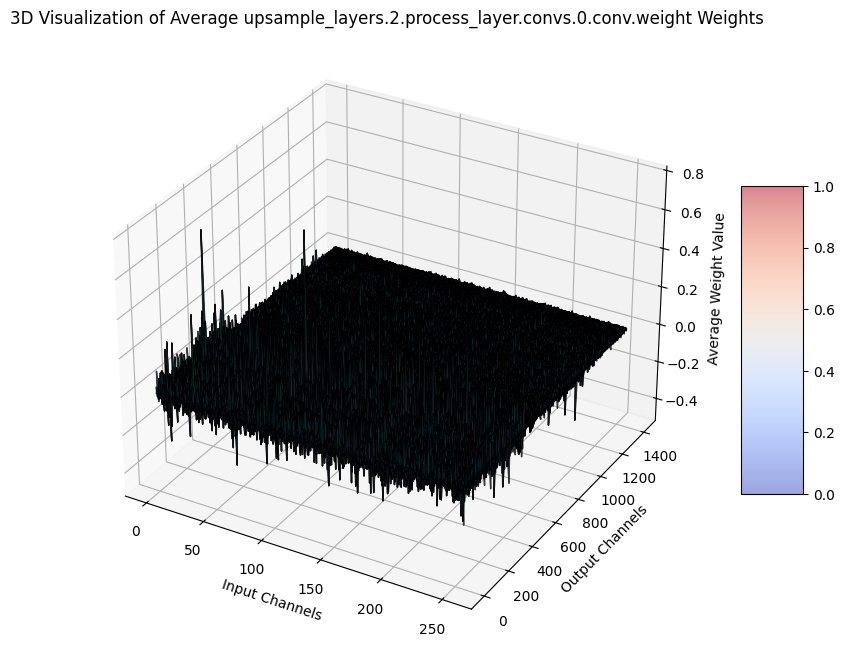

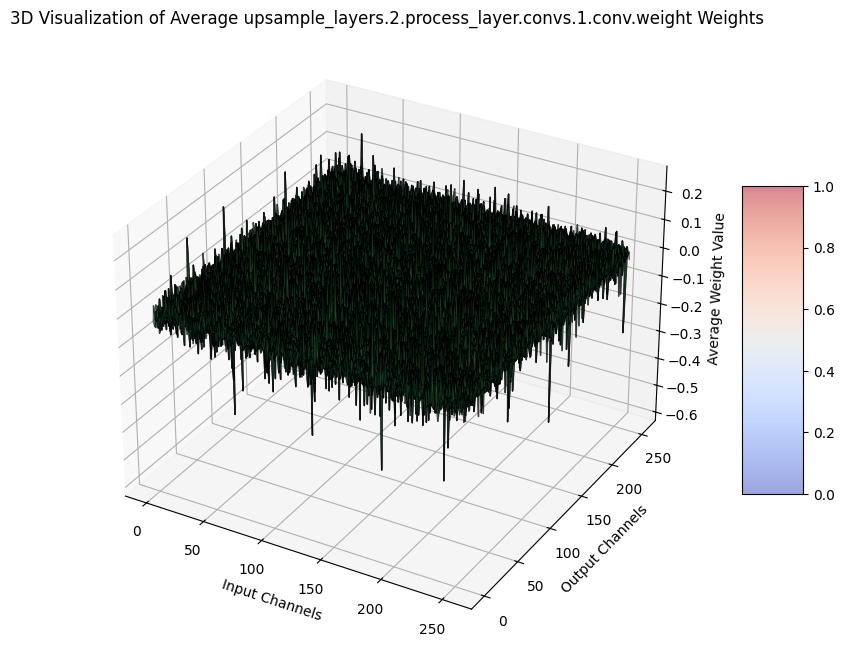

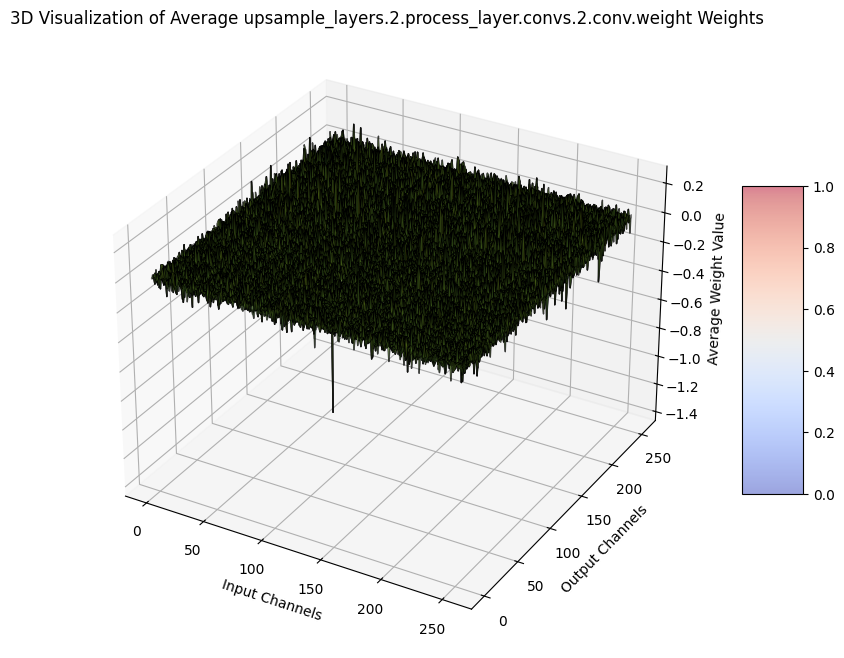

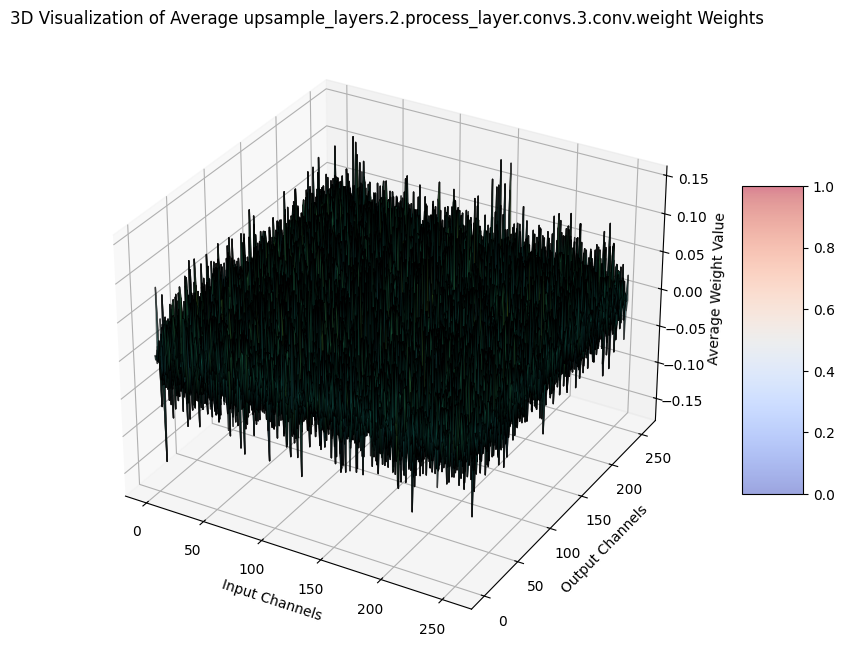

In [22]:
def plot_avg_weights_surface(model):
    for name, param in model.named_parameters():
        if "weight" in name and len(param.shape) == 3 and "upsample" in name:  # 1D Convolutional layers
            weights = param.data.cpu().numpy()  # Shape: [out_channels, in_channels, kernel_width]

            # Compute the average weights across the kernel width
            avg_weights = np.mean(weights, axis=2)  # Shape: [out_channels, in_channels]

            out_channels, in_channels = avg_weights.shape
            print(f"Plotting average weights for {name}: Shape {avg_weights.shape}")

            # Prepare data for 3D plotting
            fig = plt.figure(figsize=(12, 8))
            ax = fig.add_subplot(111, projection="3d")

            # Create meshgrid for input channels (X) and output channels (Y)
            x, y = np.meshgrid(
                np.arange(in_channels),  # Input channels
                np.arange(out_channels),  # Output channels
            )
            z = avg_weights  # Average weights for each (input_channel, output_channel) pair
            norm = plt.Normalize(z.min(), z.max())  # Normalize Z values to range [0, 1]
            facecolors = plt.cm.viridis(norm(z)) 
            # Plot the surface
            surface_plot = ax.plot_surface(
                x, y, z,  # Input channels (x), Output channels (y), Average weights (z)
                cmap="coolwarm",
                facecolors=facecolors,
                alpha=0.5,
                edgecolor="k",
                rstride=1,
                cstride=1,
            )

            # Add labels and title
            ax.set_title(f"3D Visualization of Average {name} Weights")
            ax.set_xlabel("Input Channels")
            ax.set_ylabel("Output Channels")
            ax.set_zlabel("Average Weight Value")
            fig.colorbar(surface_plot, ax=ax, shrink=0.5, aspect=5)  # Add colorbar
            fig.show()
# Call the function to plot average weights
plot_avg_weights_surface(audio_model)